In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from scipy.stats import skew

skewness = skew(df['PCA_1'])
print(f"Skewness: {skewness}")

Skewness: 5.828972694230167


In [ ]:
df = pd.read_csv("/content/drive/MyDrive/SDA TAShip/cleaned_dataset.csv")
df.columns

Index(['step', 'amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest',
       'newbalanceDest', 'isFraud', 'isFlaggedFraud', 'type_CASH_OUT',
       'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER', 'PCA_1', 'PCA_2',
       'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
       'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17',
       'PCA_18', 'PCA_19', 'PCA_20'],
      dtype='object')

# Univariate

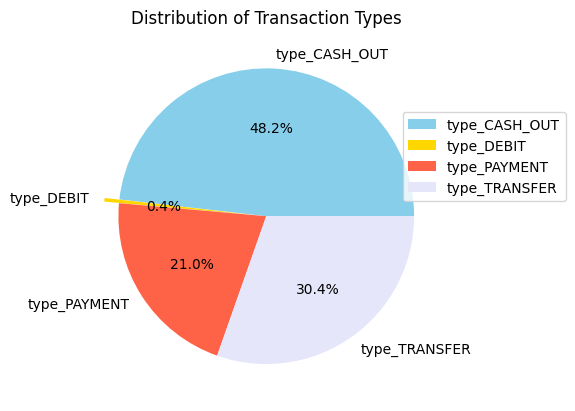

In [ ]:
# Pie Plot to show distribution of types of transactions
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()

plt.pie(transaction_type_counts, labels=['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER'], colors=['skyblue', 'gold', 'tomato', 'Lavender'],
        explode=(0, 0.1, 0, 0), autopct='%1.1f%%', startangle=0)
plt.legend(loc='upper left', bbox_to_anchor=(0.85, 0.8))
plt.title('Distribution of Transaction Types')
plt.show()

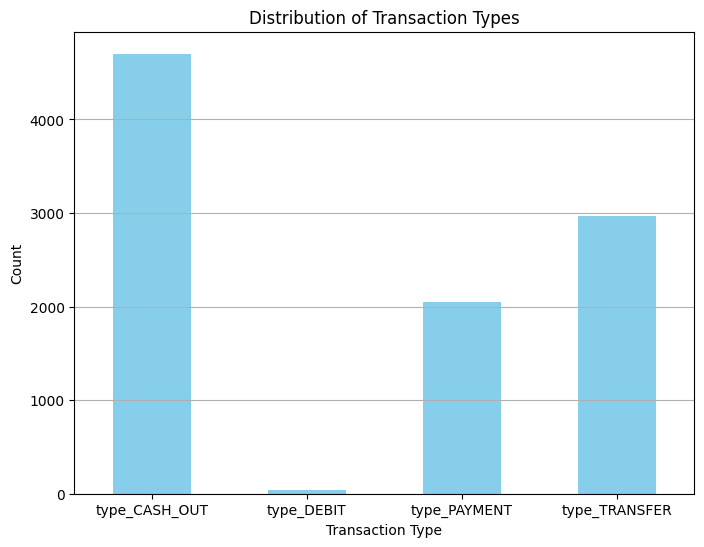

In [ ]:
# Count the occurrences of each transaction type
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()
# Create the bar chart
plt.figure(figsize=(8, 6))
transaction_type_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Transaction Types')
plt.xlabel('Transaction Type')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.grid(axis='y')
plt.show()

# Bivariate

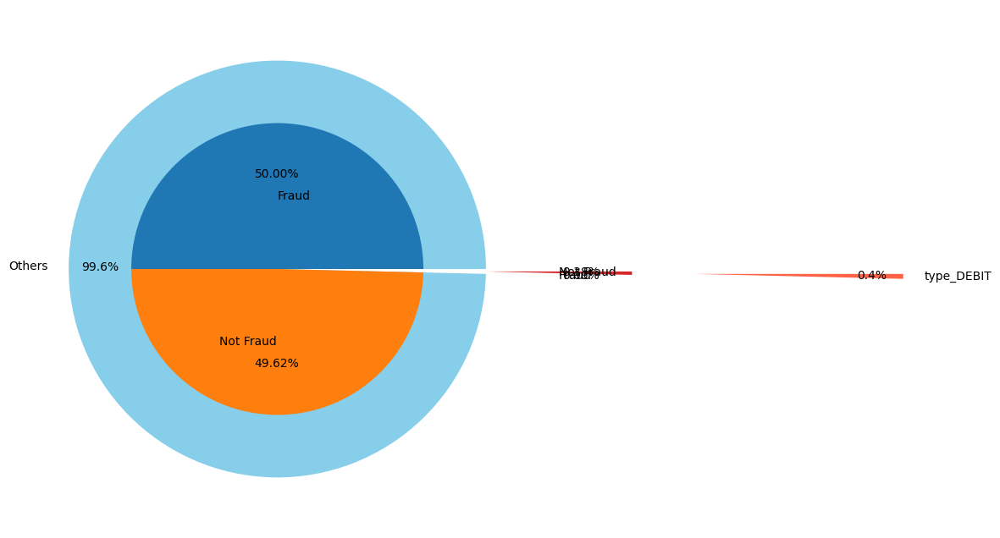

In [ ]:
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']
plt.figure(figsize=(8,8))
explode = (0, 2)
transaction = 'type_DEBIT'
plt.pie(df[transaction].value_counts(), labels=['Others', transaction],autopct='%1.1f%%', startangle=0, explode=explode , pctdistance=0.85, colors=['skyblue', 'tomato'])
fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 0)])

ins=plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
            labels=labels,
      autopct="%0.2f%%",radius=0.7,pctdistance=0.65,labeldistance=0.5,startangle=0, explode=(0,0, 1, 1))
fig = plt.gcf()
plt.show()



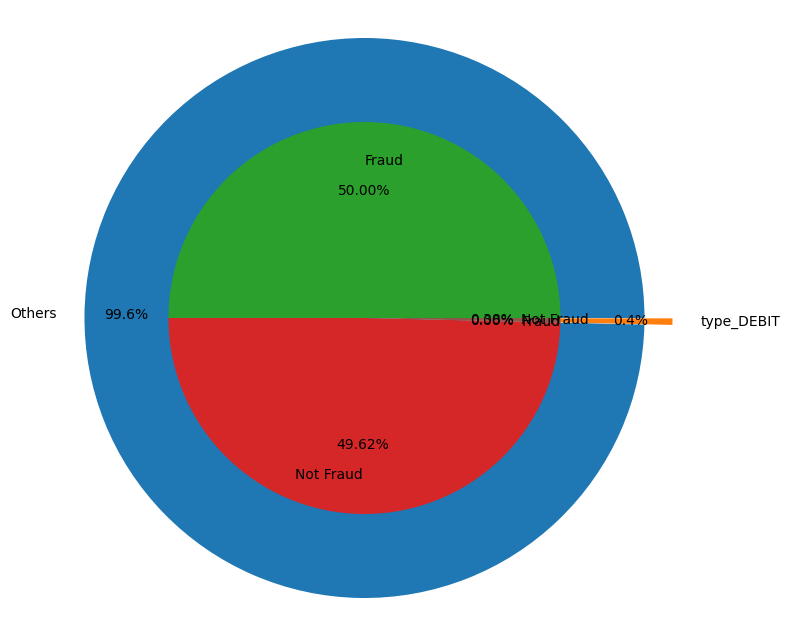

In [ ]:
import matplotlib.pyplot as plt

# Example data (replace with your actual data)
transaction = 'type_DEBIT'

# Define the labels
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']

# Create a figure with a specified size
plt.figure(figsize=(8, 8))

# Define the explode values (emphasizing the second section)
explode = (0, 0.1)  # Adjust the second value to control the explosion

# Generate the first pie chart
plt.pie(df[transaction].value_counts(), labels=['Others', transaction], autopct='%1.1f%%', startangle=0, pctdistance=0.85, explode=explode)

# Calculate counts
fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 0)])

# Generate the second pie chart (inside the first)
ins = plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
              labels=labels,
              autopct="%0.2f%%",
              radius=0.7,
              pctdistance=0.65,
              labeldistance=0.8,
              startangle=0)

# Set the aspect ratio to ensure the pie chart is circular
plt.axis('equal')

# Get the current figure
fig = plt.gcf()

# Show the figure
plt.show()


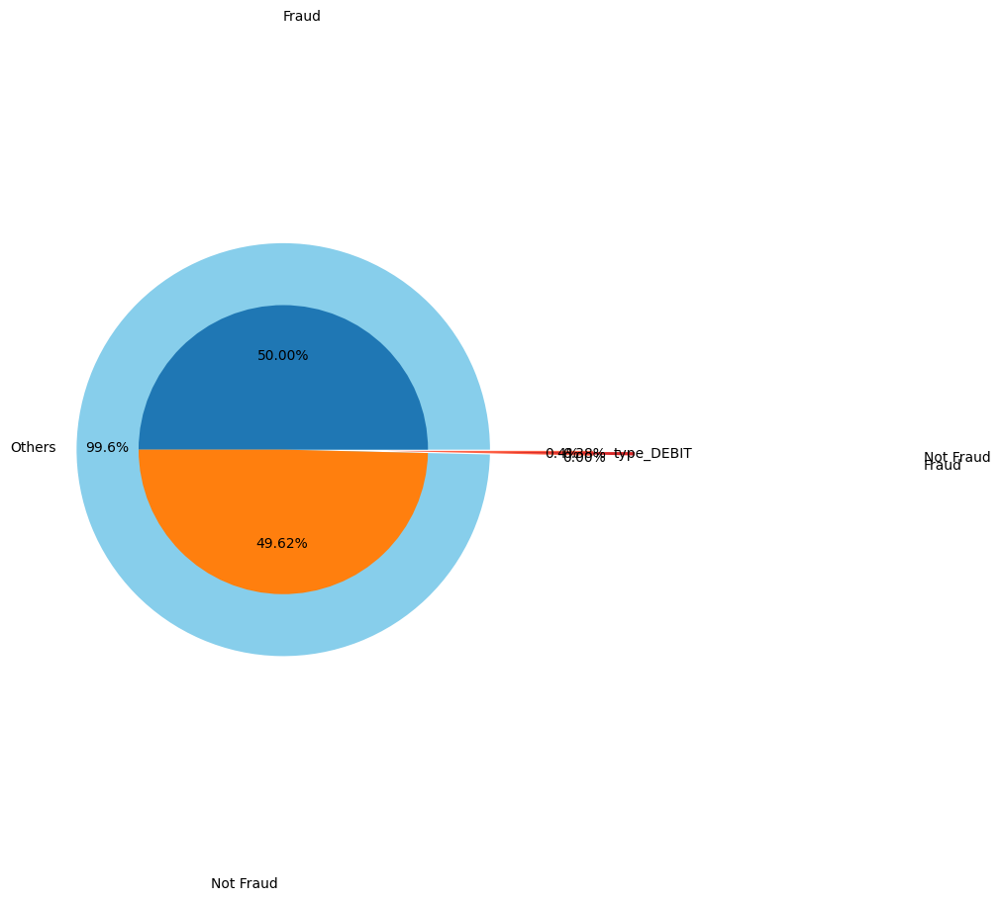

In [ ]:
import matplotlib.pyplot as plt

# Example data (replace with your actual data)
transaction = 'type_DEBIT'

# Define the labels
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']

# Create a figure with a specified size
plt.figure(figsize=(8, 8))

# Define the explode values to emphasize the 'type_DEBIT' section
explode = (0, 0.5)  # Adjust the second value to control the explosion

# Generate the pie chart for 'type_DEBIT'
plt.pie(df[transaction].value_counts(), labels=['Others', transaction], autopct='%1.1f%%', startangle=0, explode=explode, pctdistance=0.85, colors=['skyblue', 'tomato'])

# Calculate counts
fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df[transaction] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df[transaction] == 0) & (df['isFraud'] == 0)])

# Generate the second pie chart (inside the first)
ins = plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
              labels=labels,
              autopct="%0.2f%%",
              radius=0.7,
              pctdistance=0.65,
              labeldistance=3,  # Adjust this value for label positioning
              startangle=0,
              explode=(0, 0, 1, 1))

# Set the aspect ratio to ensure the pie chart is circular
plt.axis('equal')

# Get the current figure
fig = plt.gcf()

# Show the figure
plt.show()


In [ ]:
labels = ['Fraud', 'Not Fraud', 'Fraud', 'Not Fraud']
transaction_types =
plt.pie(df.type_CASH_OUT.value_counts(), labels=['Others', 'CASH_OUT'],autopct='%1.1f%%', startangle=0, pctdistance=0.80)
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()
fraud_in_type = len(df[(df['type_CASH_OUT'] == 1) & (df['isFraud'] == 1)])
not_fraud_in_type = len(df[(df['type_CASH_OUT'] == 1) & (df['isFraud'] == 0)])

fraud_in_others = len(df[(df['type_CASH_OUT'] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df['type_CASH_OUT'] == 0) & (df['isFraud'] == 0)])

ins=plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type, not_fraud_in_type],
            labels=labels,
       autopct="%0.2f%%",radius=0.7,pctdistance=0.65,labeldistance=0.4,startangle=0, textprops={'fontsize': 8})
hole = plt.Circle((0, 0), 0.4, color='white', linewidth=0)
fig = plt.gcf()
plt.show()

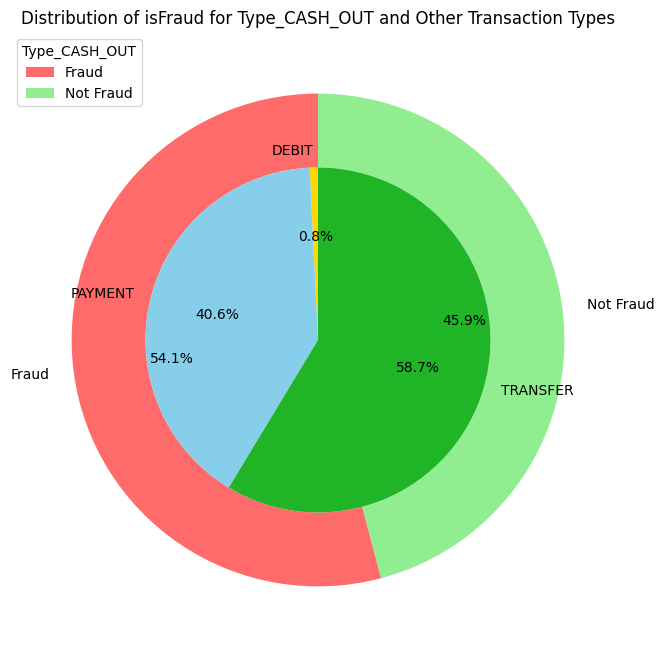

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter data for type_CASH_OUT transactions
type_cash_out = df[df['type_CASH_OUT'] == 1]

# Calculate the distribution of 'isFraud' for type_CASH_OUT transactions
fraud_counts = type_cash_out[type_cash_out['isFraud'] == 1].shape[0]
non_fraud_counts = type_cash_out[type_cash_out['isFraud'] == 0].shape[0]

# Create the nested pie chart
fig, ax = plt.subplots(figsize=(8, 8))

# Inner pie chart for 'isFraud' and 'not isFraud' distribution
inner_labels = ['Fraud', 'Not Fraud']
inner_sizes = [fraud_counts, non_fraud_counts]
inner_colors = ['#FF6B6B', '#90EE90']
ax.pie(inner_sizes, labels=inner_labels, autopct='%1.1f%%', startangle=90, colors=inner_colors)

# Set a circle in the center to create a donut chart
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

# Outer pie chart for the distribution of 'type' other than 'CASH_OUT'
outer_labels = ['DEBIT', 'PAYMENT', 'TRANSFER']
outer_sizes = [
    df[df['type_DEBIT'] == 1].shape[0],
    df[df['type_PAYMENT'] == 1].shape[0],
    df[df['type_TRANSFER'] == 1].shape[0]
]
outer_colors = ['#FFD700', '#87CEEB', '#1fb527']
ax.pie(outer_sizes, labels=outer_labels, autopct='%1.1f%%', startangle=90, radius=0.7, colors=outer_colors)

# Add a legend
ax.legend(inner_labels, title='Type_CASH_OUT', loc='upper left')

# Set the title
plt.title('Distribution of isFraud for Type_CASH_OUT and Other Transaction Types')

plt.show()


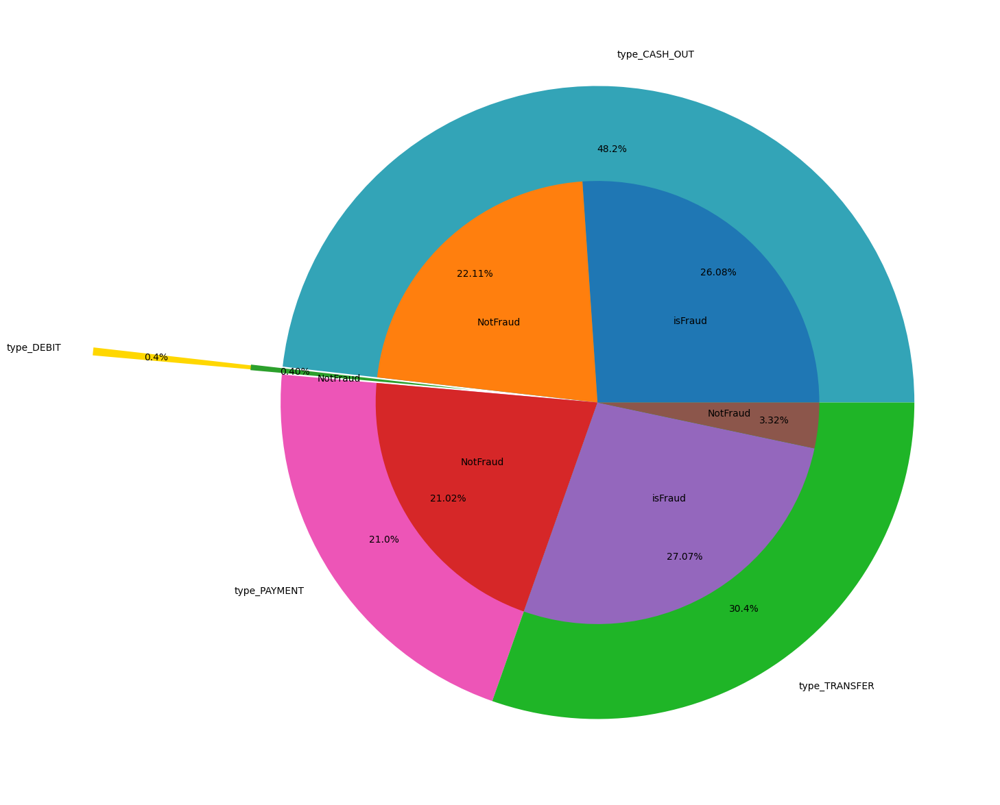

In [ ]:
plt.figure(figsize=(15,15))
transaction_type_counts = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()

#outside donut
out=plt.pie(transaction_type_counts, labels=['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER'], colors=['#33a4b7', 'gold', '#ed55b7', '#1fb527'],
        explode=(0, 0.6, 0, 0), autopct='%1.1f%%', startangle=0, pctdistance=0.80)

#inside donut
ins=plt.pie(np.concatenate((df[df.type_CASH_OUT==1].isFraud.value_counts().values,
                            df[df.type_DEBIT==1].isFraud.value_counts().values,
                            df[df.type_PAYMENT==1].isFraud.value_counts().values,
                            df[df.type_TRANSFER==1].isFraud.value_counts().values)),
            labels=['isFraud', 'NotFraud', 'NotFraud', 'NotFraud', 'isFraud', 'NotFraud'],
       autopct="%0.2f%%",radius=0.7,pctdistance=0.80,startangle=0, labeldistance=0.5, explode=(0,0,0.4,0,0,0))
hole = plt.Circle((0, 0), 0.4, color='white', linewidth=0)
fig = plt.gcf()
plt.show()
#plt.gcf().gca().add_artist(hole)

In [ ]:
len(df[(df['type_CASH_OUT'] == 1) & (df['isFraud'] == 1)])


2545

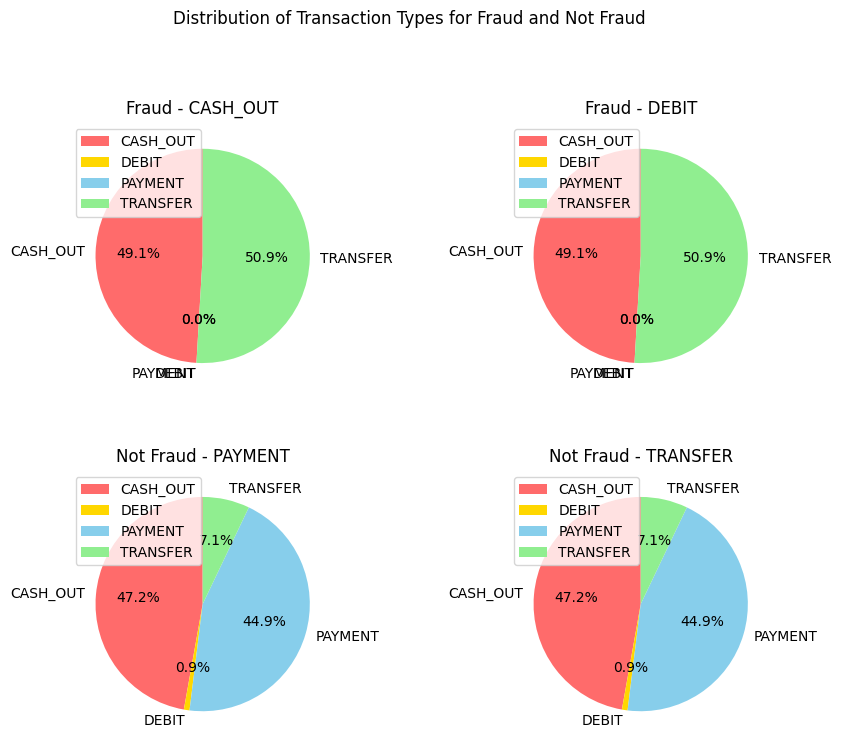

In [ ]:
# Calculate the counts of each transaction type for fraud and not fraud
fraud_counts = df[df['isFraud'] == 1][['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()
non_fraud_counts = df[df['isFraud'] == 0][['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum()

# Define labels for the pie charts
labels = ['CASH_OUT', 'DEBIT', 'PAYMENT', 'TRANSFER']

# Create subplots for four pie charts
fig, axes = plt.subplots(2, 2, figsize=(10, 8))
plt.subplots_adjust(wspace=0.3, hspace=0.3)

# Pie chart for Fraud - CASH_OUT
axes[0, 0].pie(fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[0, 0].set_title('Fraud - CASH_OUT')

# Pie chart for Fraud - DEBIT
axes[0, 1].pie(fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[0, 1].set_title('Fraud - DEBIT')

# Pie chart for Not Fraud - PAYMENT
axes[1, 0].pie(non_fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[1, 0].set_title('Not Fraud - PAYMENT')

# Pie chart for Not Fraud - TRANSFER
axes[1, 1].pie(non_fraud_counts, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#FF6B6B', '#FFD700', '#87CEEB', '#90EE90'])
axes[1, 1].set_title('Not Fraud - TRANSFER')

# Add legends
for ax in axes.flatten():
    ax.legend(labels, loc='best')

# Display the subplots
plt.suptitle('Distribution of Transaction Types for Fraud and Not Fraud', y=1.02)
plt.show()

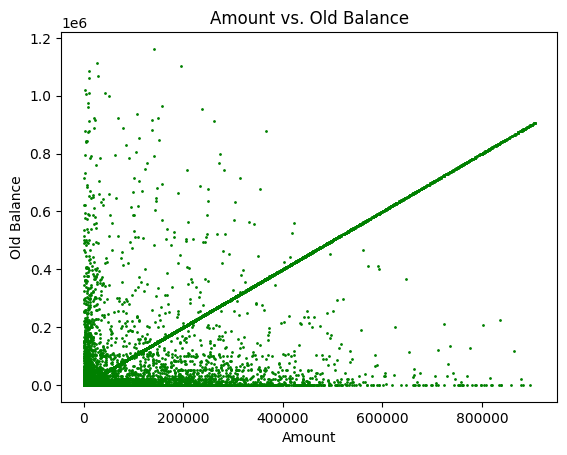

In [ ]:
plt.scatter(df['amount'], df['oldbalanceOrg'], s=1, c='green')
plt.xlabel('Amount')
plt.ylabel('Old Balance')
plt.title('Amount vs. Old Balance')
plt.show()

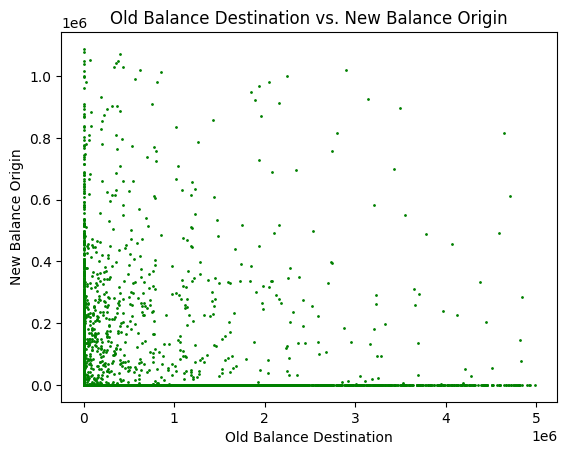

In [ ]:
plt.scatter(df['oldbalanceDest'], df['newbalanceOrig'], s=1, c='green')
plt.xlabel('Old Balance Destination')
plt.ylabel('New Balance Origin')
plt.title('Old Balance Destination vs. New Balance Origin')
plt.show()

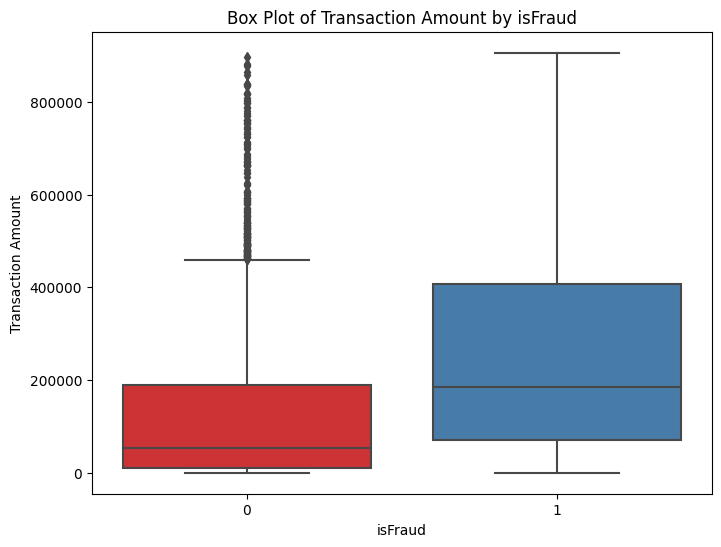

In [ ]:
# Create a box plot to visualize the distribution of 'amount' for 'isFraud' levels
plt.figure(figsize=(8, 6))
sns.boxplot(x='isFraud', y='amount', data=df, palette='Set1')
plt.title('Box Plot of Transaction Amount by isFraud')
plt.xlabel('isFraud')
plt.ylabel('Transaction Amount')
plt.show()

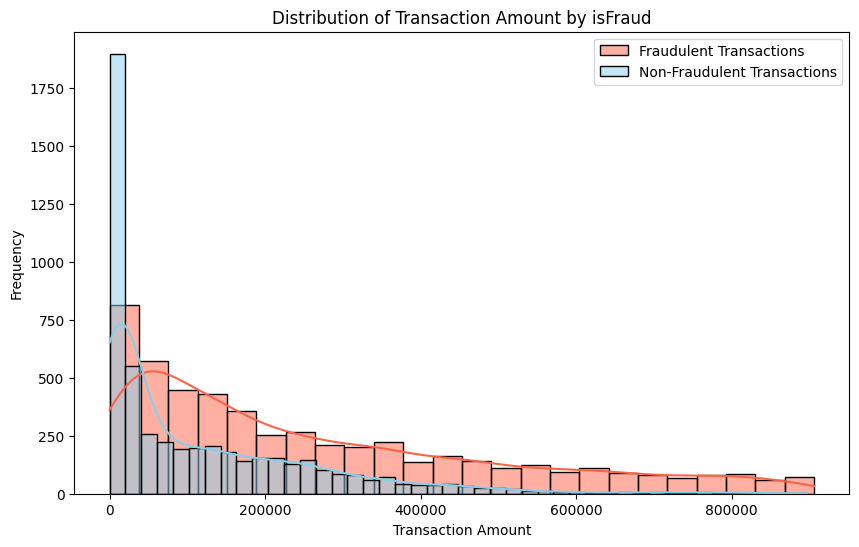

In [ ]:
# Create separate data frames for 'isFraud' levels
fraudulent_transactions = df[df['isFraud'] == 1]
non_fraudulent_transactions = df[df['isFraud'] == 0]

# Set the figure size
plt.figure(figsize=(10, 6))

# Create histograms for 'amount' for fraudulent transactions (red)
sns.histplot(fraudulent_transactions['amount'], kde=True, color='tomato', label='Fraudulent Transactions')

# Create histograms for 'amount' for non-fraudulent transactions (blue)
sns.histplot(non_fraudulent_transactions['amount'], kde=True, color='skyblue', label='Non-Fraudulent Transactions')

# Set plot labels and title
plt.title('Distribution of Transaction Amount by isFraud')
plt.xlabel('Transaction Amount')
plt.ylabel('Frequency')

# Add a legend
plt.legend()

# Display the plot
plt.show()

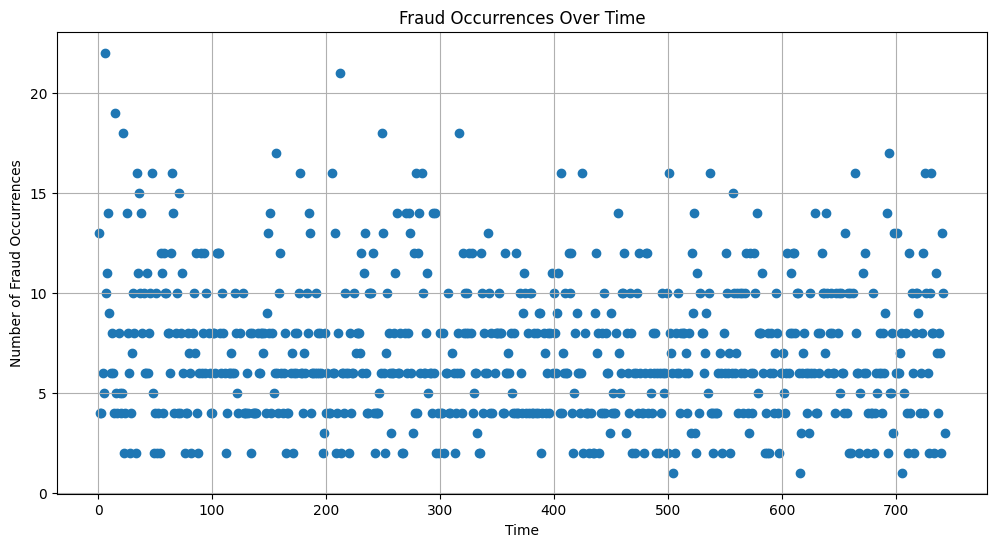

In [ ]:
# Group the data by the 'step' and count the number of fraud occurrences in each time period
fraud_count = df[df['isFraud'] == 1].groupby('step').size()

# Create a line plot
plt.scatter(fraud_count.index, fraud_count.values, marker='o', linestyle='-')
plt.title('Fraud Occurrences Over Time')
plt.xlabel('Time')
plt.ylabel('Number of Fraud Occurrences')
plt.grid(True)
plt.show()


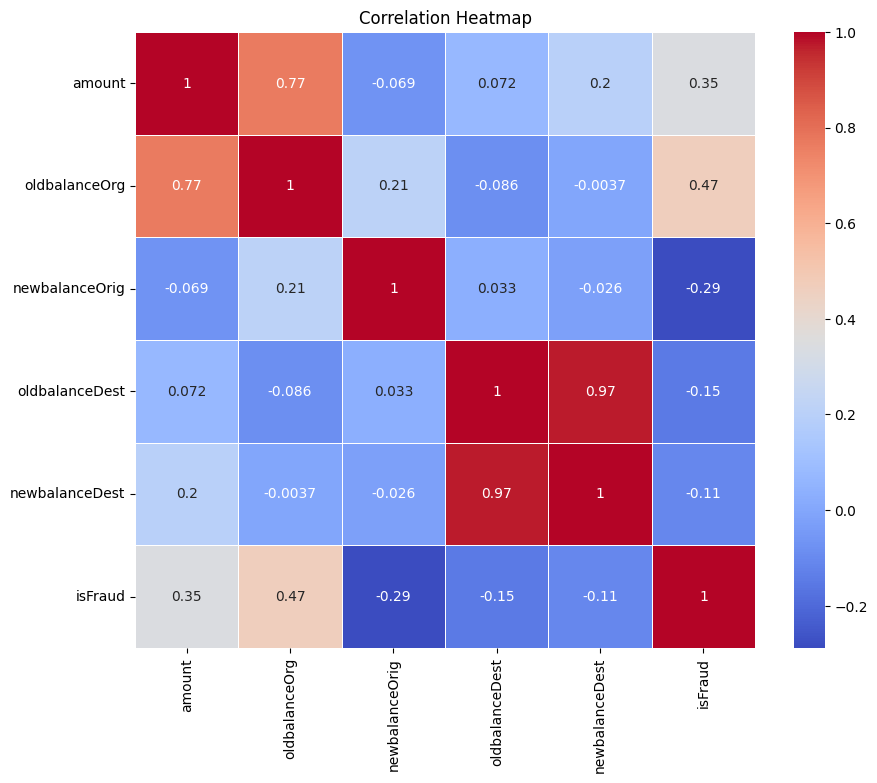

In [ ]:

selected_features = df[['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest', 'isFraud']]

correlation_matrix = selected_features.corr()

plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()


In [ ]:
# Group the data by transaction type and calculate the count of frauds
fraud_counts_by_type = df.groupby('transaction_type')['isFraud'].sum().reset_index()

plt.figure(figsize=(8, 6))
plt.bar(fraud_counts_by_type['transaction_type'], fraud_counts_by_type['isFraud'], color='tomato')
plt.title('Fraud Counts by Transaction Type')
plt.xlabel('Transaction Type')
plt.ylabel('Fraud Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.grid(axis='y')
plt.show()


KeyError: ignored

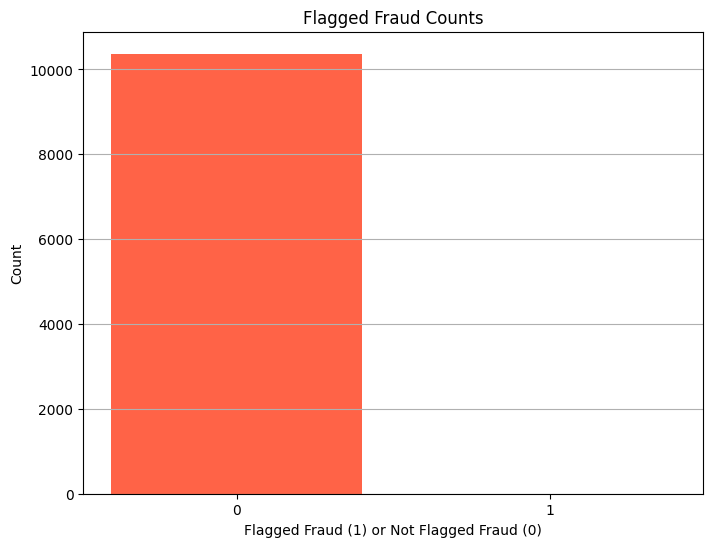

In [ ]:
# Problematic because probably we have deleted all the rows which are flagged fraud :((

# Group the data by 'isFlaggedFraud' and calculate the count of flagged fraud
flagged_fraud_counts = df['isFlaggedFraud'].value_counts().reset_index()
flagged_fraud_counts.columns = ['isFlaggedFraud', 'Count']

plt.figure(figsize=(8, 6))
plt.bar(flagged_fraud_counts['isFlaggedFraud'], flagged_fraud_counts['Count'], color=['tomato', 'lightblue'])
plt.title('Flagged Fraud Counts')
plt.xlabel('Flagged Fraud (1) or Not Flagged Fraud (0)')
plt.ylabel('Count')
plt.xticks(flagged_fraud_counts['isFlaggedFraud'])  # Set x-axis labels to 0 and 1
plt.grid(axis='y')
plt.show()


In [ ]:
# Define the bin edges
bin_edges = [0, 100, 200, 300, 400, 500]  # Customize these bins as needed

# Create bins for transaction amounts
df['amount_bins'] = pd.cut(df['amount'], bin_edges)

# Count the transactions in each amount bin
transaction_counts_by_bin = df['amount_bins'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
transaction_counts_by_bin.plot(kind='bar', color='skyblue')
plt.title('Transaction Counts by Amount Bins')
plt.xlabel('Amount Bins')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.grid(axis='y')
plt.show()


NameError: ignored

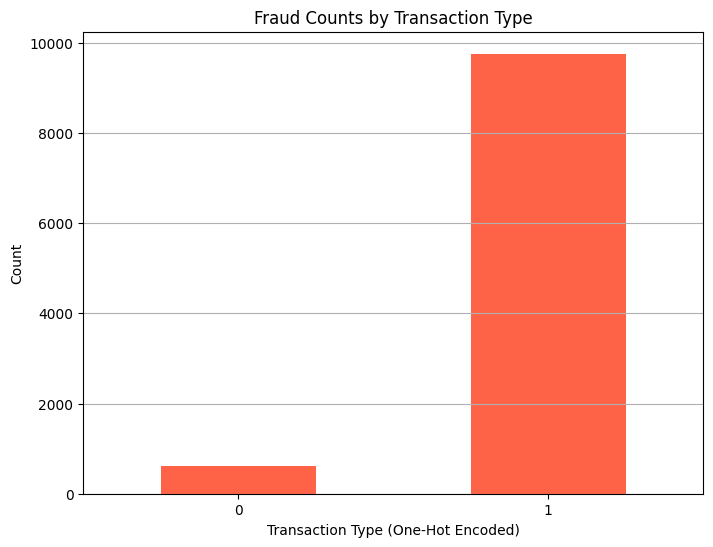

In [ ]:
# Create a new column 'fraud_count' that sums the one-hot-encoded columns for each row
df['fraud_count'] = df[['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']].sum(axis=1)

# Group the data by 'fraud_count' and calculate the count of transactions for each 'fraud_count'
fraud_counts_by_type = df.groupby('fraud_count').size()

# Create the bar chart
plt.figure(figsize=(8, 6))
fraud_counts_by_type.plot(kind='bar', color='tomato')
plt.title('Fraud Counts by Transaction Type')
plt.xlabel('Transaction Type (One-Hot Encoded)')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.grid(axis='y')
plt.show()

type_CASH_OUT    2545
type_DEBIT          0
type_PAYMENT        0
type_TRANSFER    2641
isFraud          5186
dtype: int64


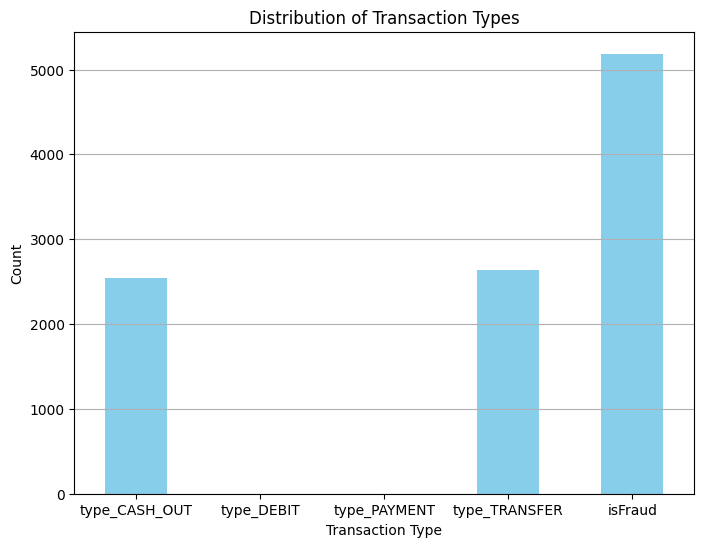

In [ ]:
# Count the occurrences of each transaction type
# Select the transaction type columns and 'isFraud' column
transaction_type_columns = ['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']
transaction_type_columns.append('isFraud')

# Filter the DataFrame to include rows where 'isFraud' is true
fraudulent_transactions = df[df['isFraud'] == 1]

# Get the count of true 'isFraud' for each transaction type
transaction_type_counts = fraudulent_transactions[transaction_type_columns].sum()

print(transaction_type_counts)

# Create the bar chart
plt.figure(figsize=(8, 6))
transaction_type_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Transaction Types')
plt.xlabel('Transaction Type')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed
plt.grid(axis='y')
plt.show()

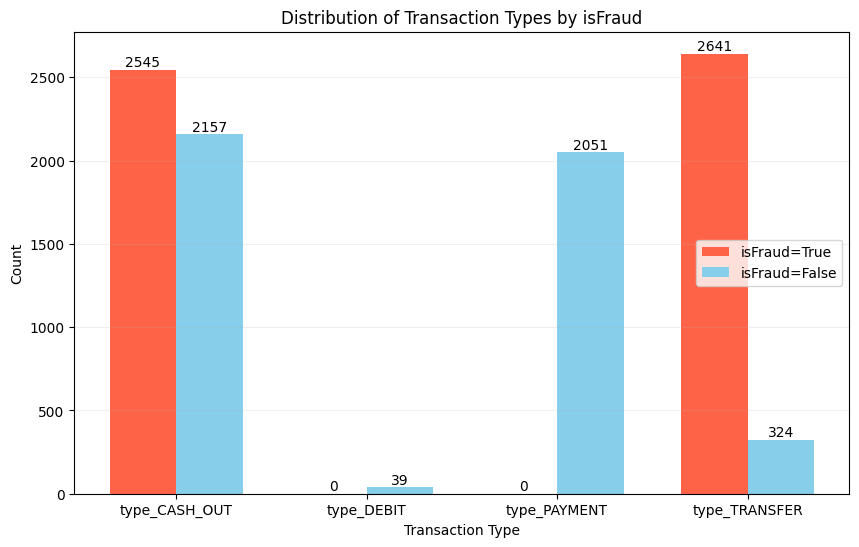

In [ ]:
# Define the transaction types
transaction_types = ['type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']

# Initialize lists to store counts for 'isFraud' true and false
fraud_counts_true = []
fraud_counts_false = []

# Calculate counts for each transaction type
for transaction_type in transaction_types:
    # 'isFraud' true count
    count_true = len(df[(df[transaction_type] == 1) & (df['isFraud'] == 1)])
    fraud_counts_true.append(count_true)

    # 'isFraud' false count
    count_false = len(df[(df[transaction_type] == 1) & (df['isFraud'] == 0)])
    fraud_counts_false.append(count_false)

# Create the bar chart
plt.figure(figsize=(10, 6))
width = 0.35
x = range(len(transaction_types))

bars1 = plt.bar(x, fraud_counts_true, width, label='isFraud=True', color='tomato')
bars2 = plt.bar([i + width for i in x], fraud_counts_false, width, label='isFraud=False', color='skyblue')

# Add count labels on top of the bars
for bar1, bar2 in zip(bars1, bars2):
    plt.text(bar1.get_x() + bar1.get_width() / 2, bar1.get_height(), str(int(bar1.get_height())),
             ha='center', va='bottom', color='black')
    plt.text(bar2.get_x() + bar2.get_width() / 2, bar2.get_height(), str(int(bar2.get_height())),
             ha='center', va='bottom', color='black')

plt.title('Distribution of Transaction Types by isFraud')
plt.xlabel('Transaction Type')
plt.ylabel('Count')
plt.xticks([i + width/2 for i in x], transaction_types)

# Move the legend to the right side in the middle
plt.legend(loc='center right')

plt.grid(axis='y', alpha=0.2)
plt.show()


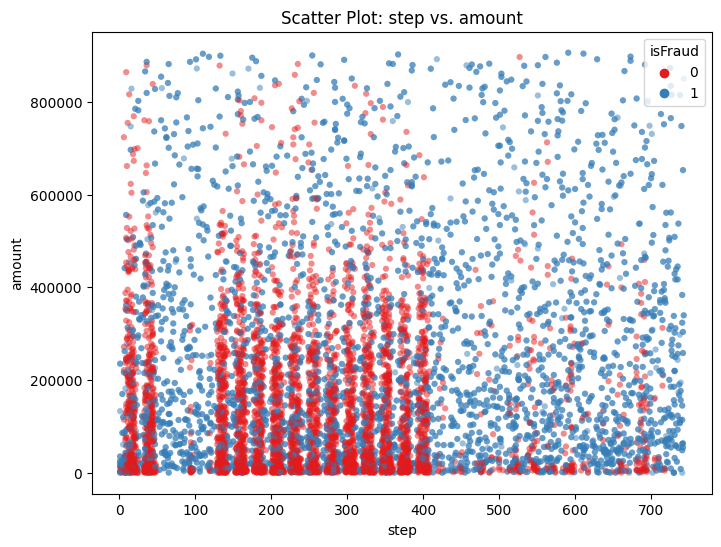

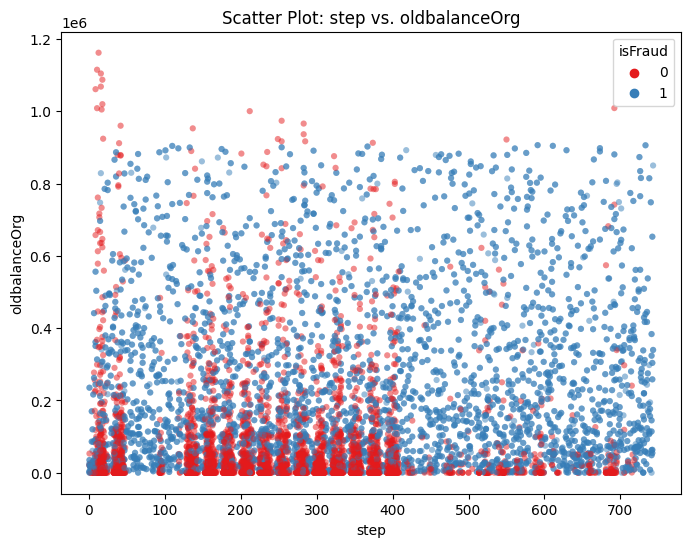

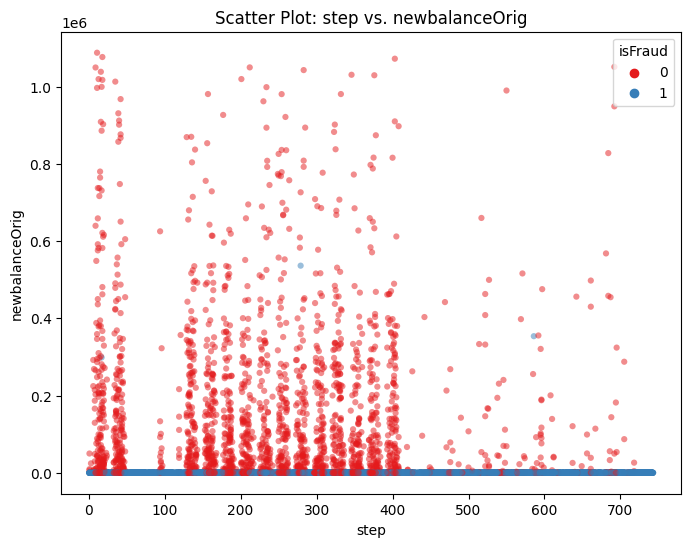

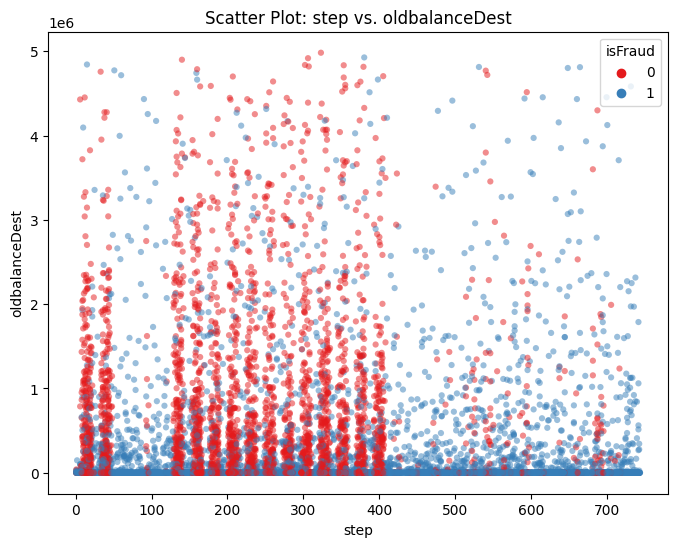

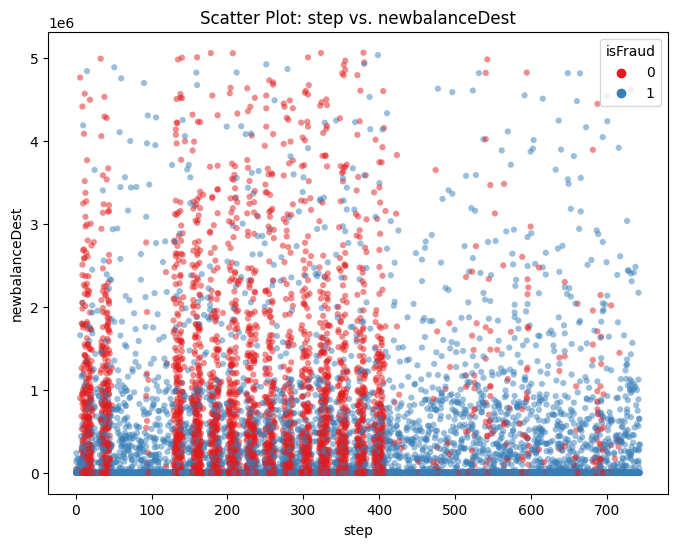

...

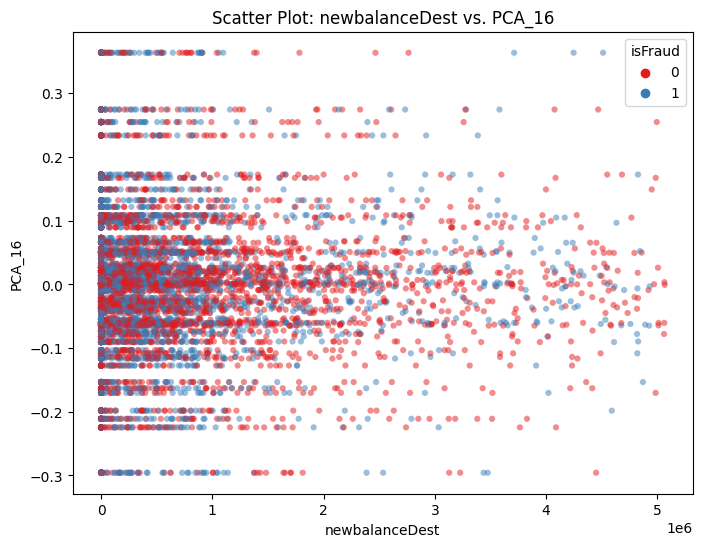

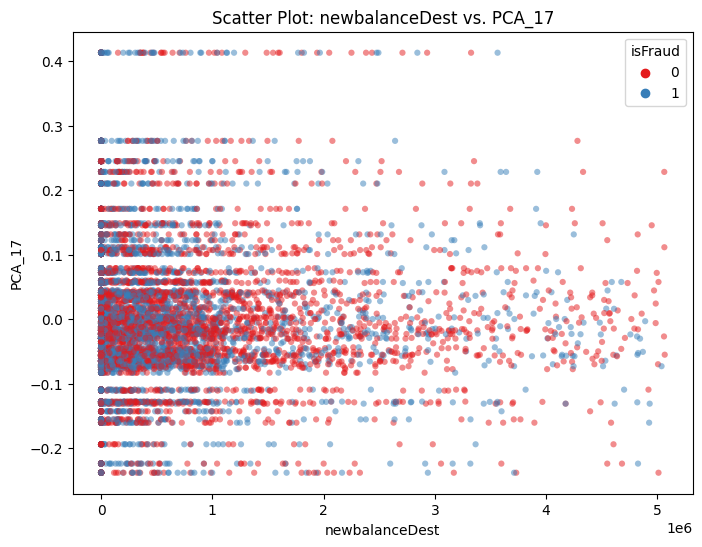

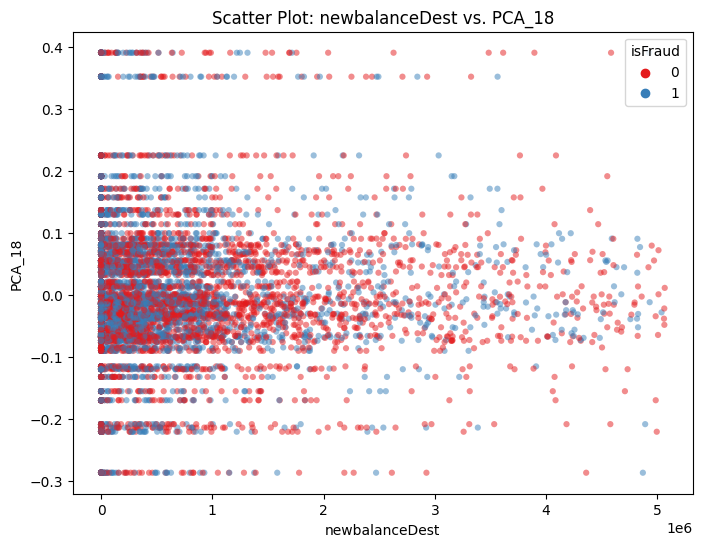

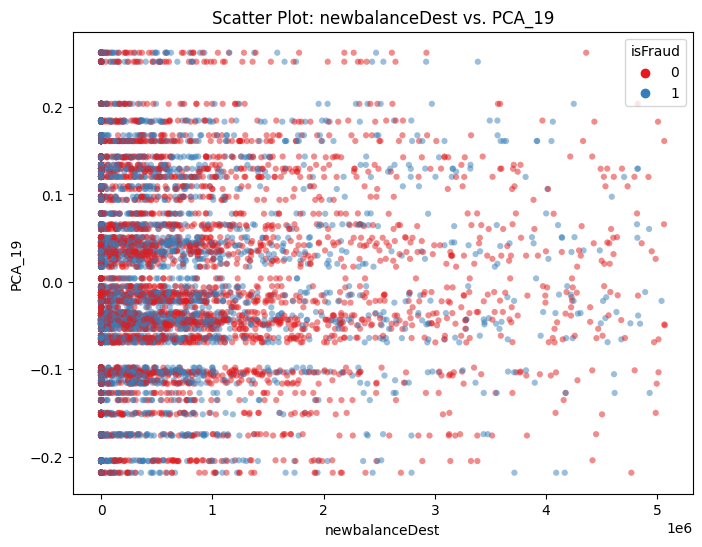

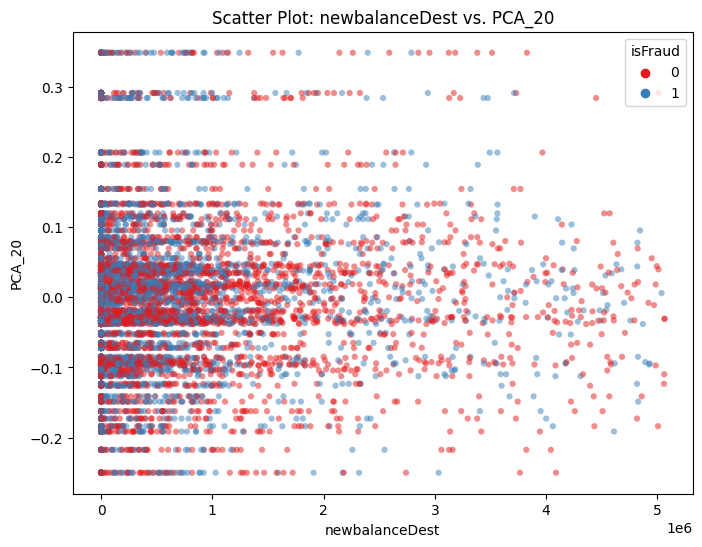

TypeError: ignored

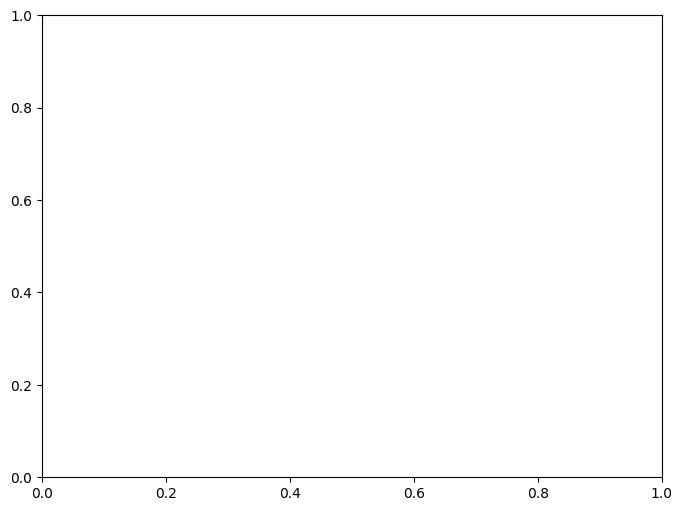

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Select the attributes for bivariate analysis
attributes = ['step', 'amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest',
              'isFraud', 'isFlaggedFraud', 'type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER',
              'PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
              'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17', 'PCA_18', 'PCA_19', 'PCA_20']

# Generate all possible pairs of attributes for bivariate analysis
bivariate_pairs = [(x, y) for i, x in enumerate(attributes) for j, y in enumerate(attributes) if i < j]

# Plot various types of bivariate data visualizations
for pair in bivariate_pairs:
    x, y = pair

    if x == 'isFraud':
        continue  # Skip 'isFraud' vs. 'isFraud' comparisons

    if x in ['isFraud', 'isFlaggedFraud', 'type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']:
        # For categorical vs. numerical attributes
        plt.figure(figsize=(8, 6))
        sns.boxplot(x=x, y=y, data=df, palette='Set1', alpha=0.5)
        plt.title(f'Box Plot: {x} vs. {y}')
    else:
        # For numerical vs. numerical attributes
        plt.figure(figsize=(8, 6))
        sns.scatterplot(x=x, y=y, data=df, hue='isFraud', palette='Set1', edgecolor='none', alpha=0.5, s=20)  # Remove marker outlines
        plt.title(f'Scatter Plot: {x} vs. {y}')

    plt.xlabel(x)
    plt.ylabel(y)
    plt.legend(title='isFraud', loc='upper right')

    plt.show()


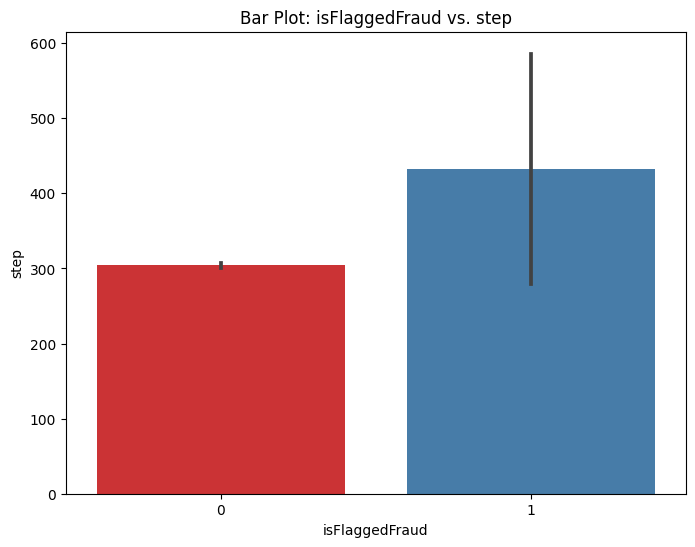

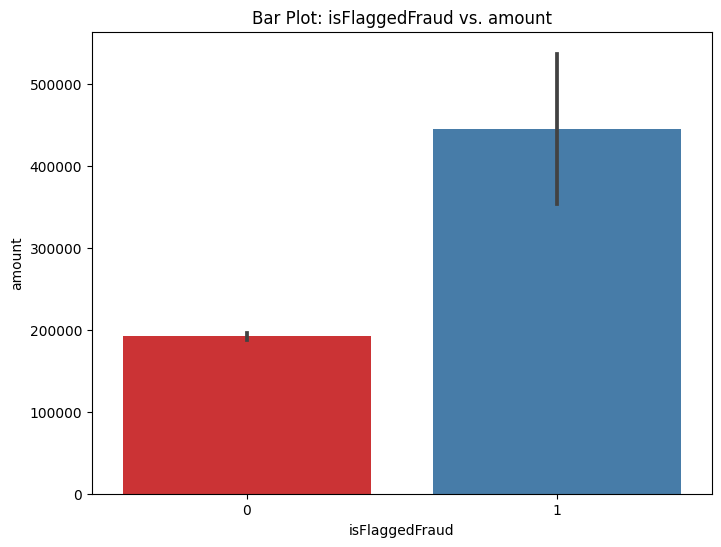

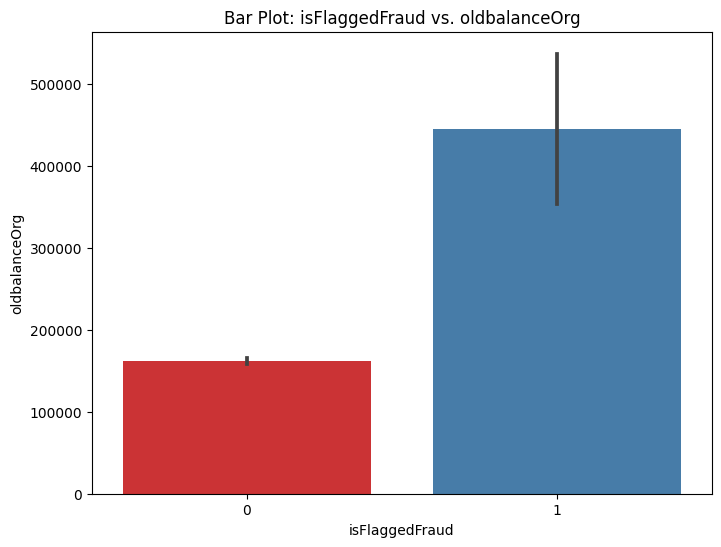

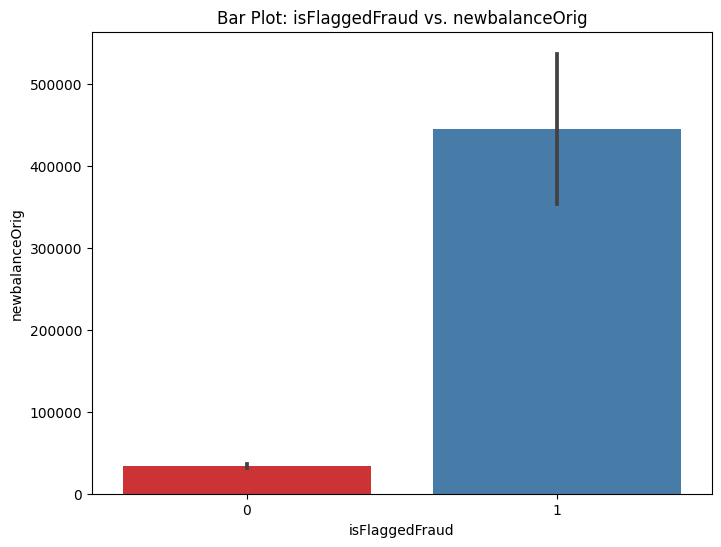

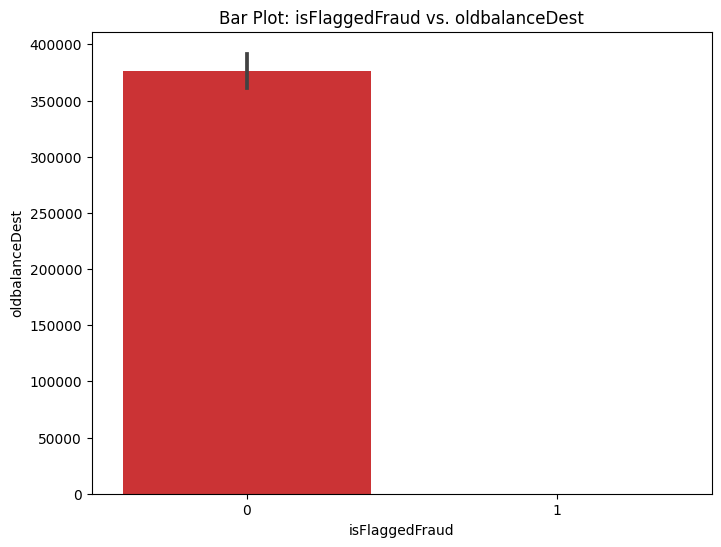

...

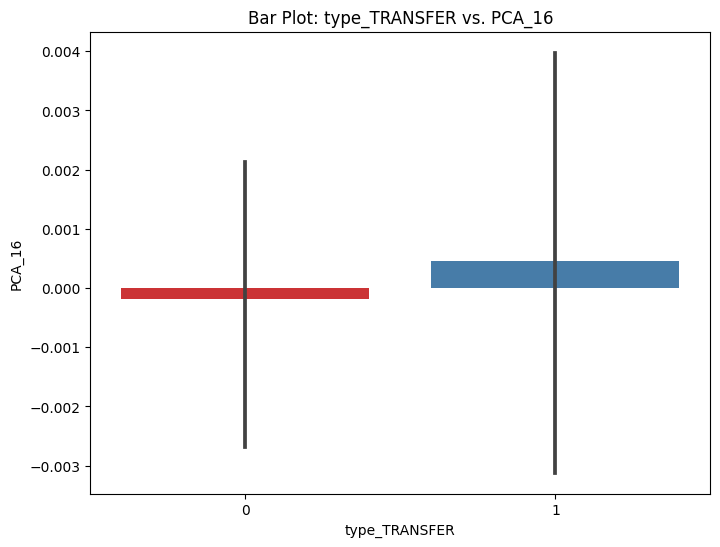

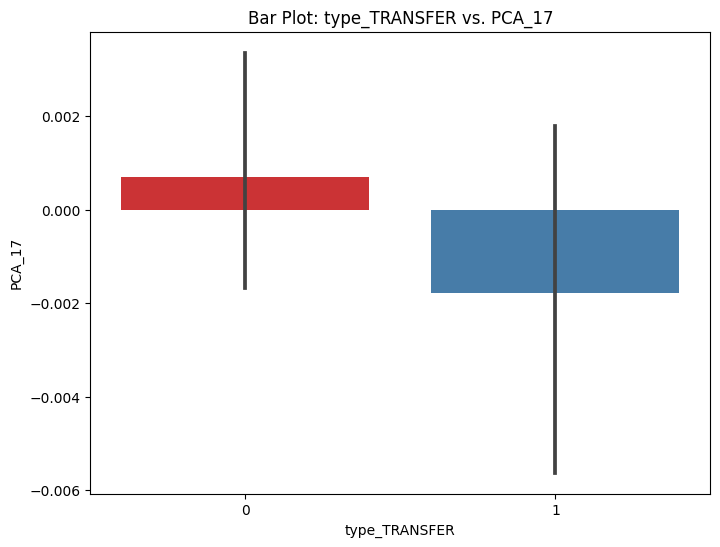

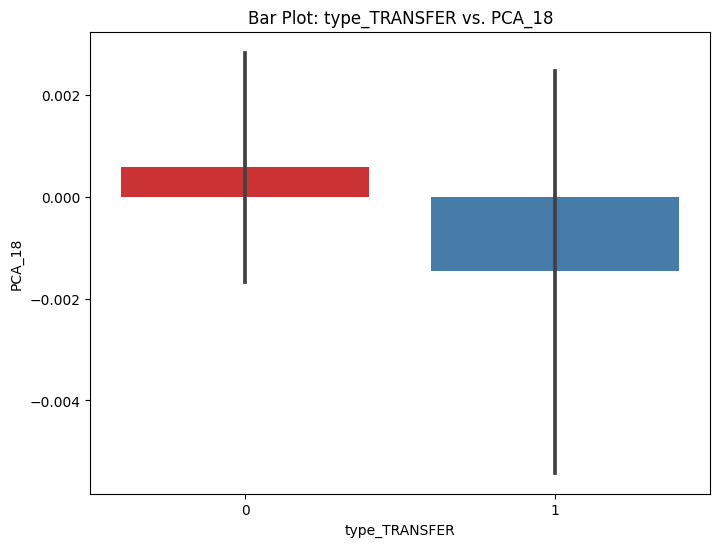

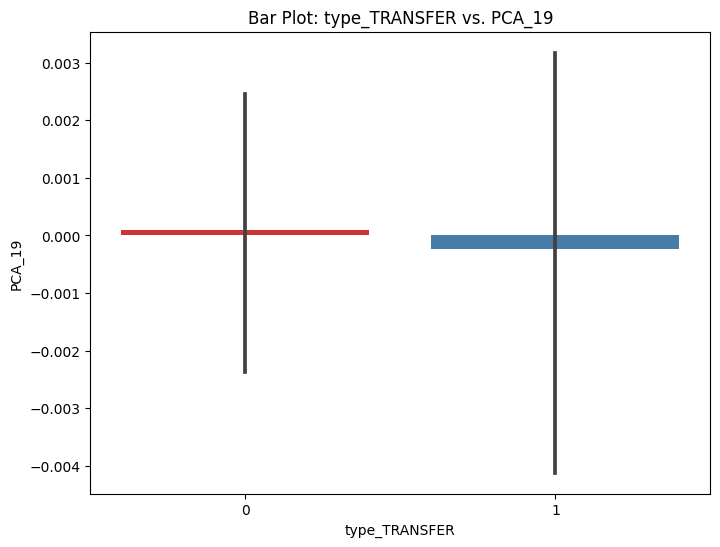

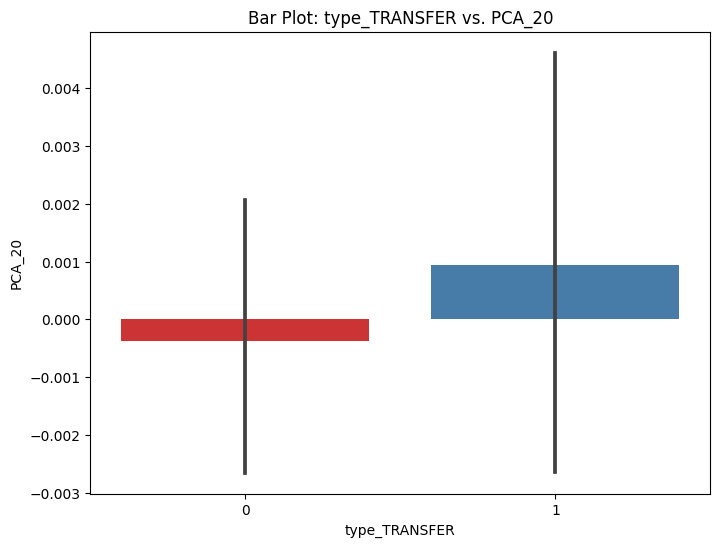

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Select the attributes for bar plot analysis
categorical_attributes = ['isFraud', 'isFlaggedFraud', 'type_CASH_OUT', 'type_DEBIT', 'type_PAYMENT', 'type_TRANSFER']

# Generate all possible combinations of categorical attributes
categorical_combinations = [(x, y) for x in categorical_attributes for y in categorical_attributes if x != y]

# Generate bar plots for numeric attributes grouped by categorical attributes
for x in categorical_attributes:
    for y in [attr for attr in attributes if attr not in categorical_attributes]:
        if x == 'isFraud':
            continue  # Skip 'isFraud' vs. numerical attributes
        plt.figure(figsize=(8, 6))
        sns.barplot(x=x, y=y, data=df, palette='Set1')
        plt.title(f'Bar Plot: {x} vs. {y}')
        plt.xlabel(x)
        plt.ylabel(y)
        plt.show()


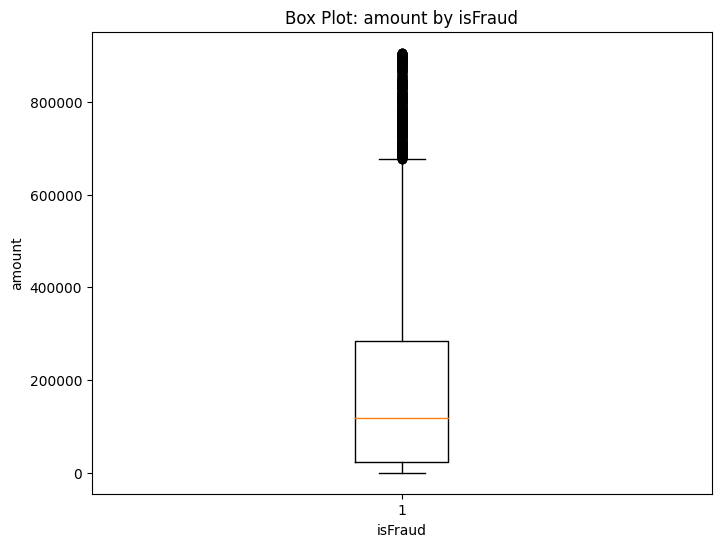

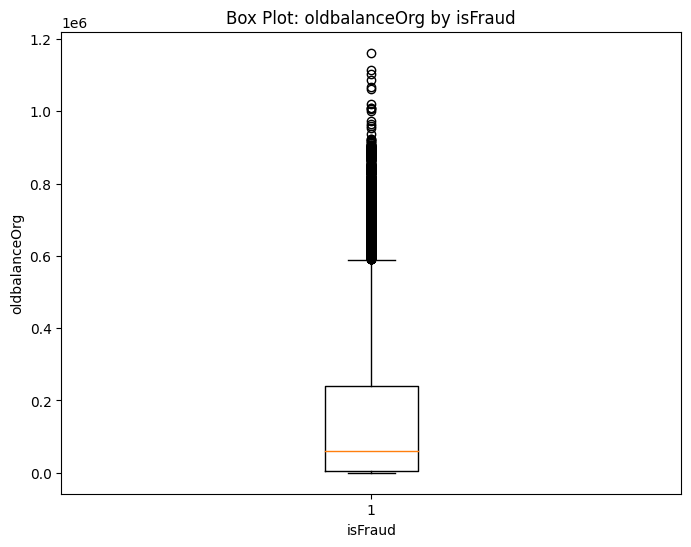

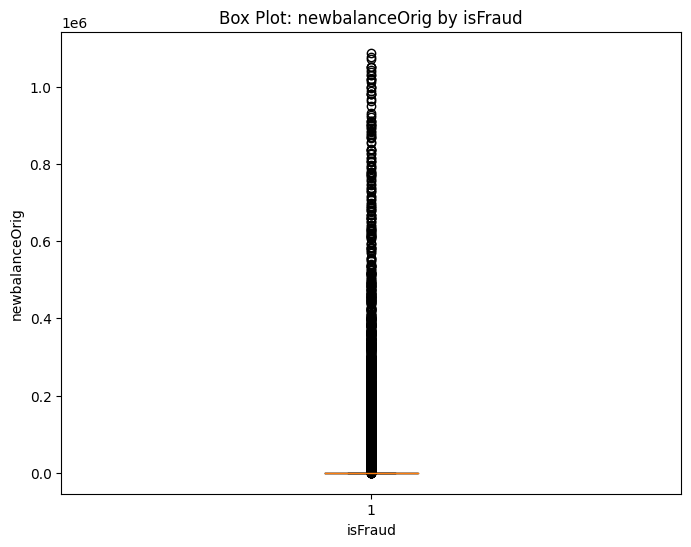

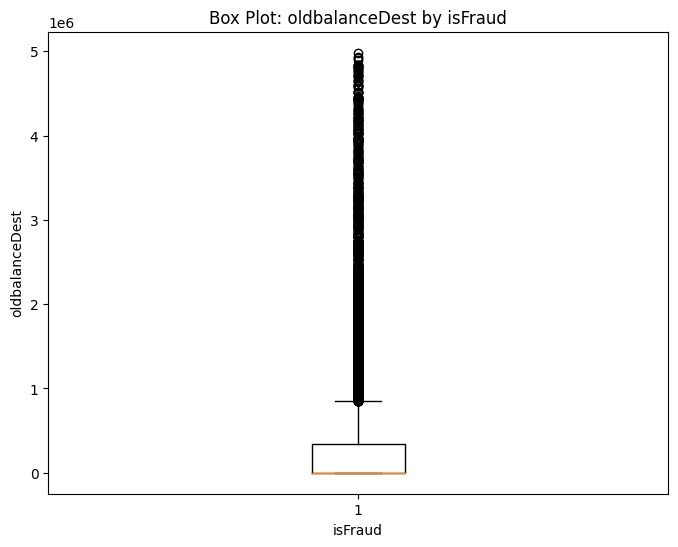

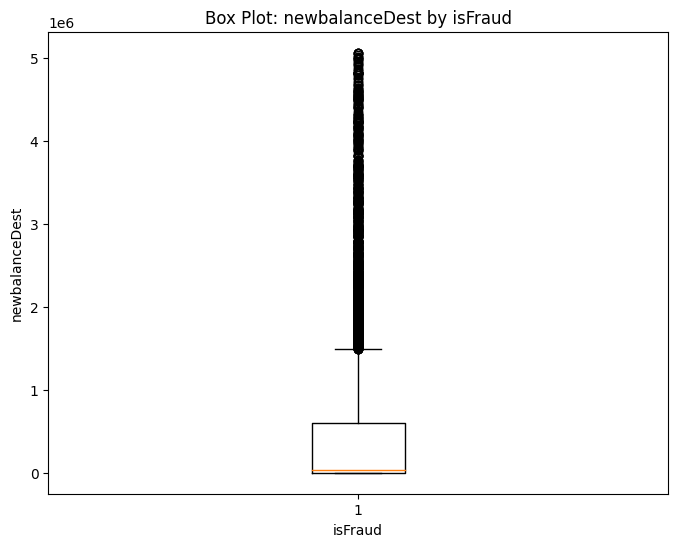

In [ ]:
# Select the attributes for box plot analysis
attributes = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Generate box plots for each selected attribute
for attribute in attributes:
    plt.figure(figsize=(8, 6))
    plt.boxplot(df[attribute])
    plt.title(f'Box Plot: {attribute} by isFraud')
    plt.xlabel('isFraud')
    plt.ylabel(attribute)
    plt.show()

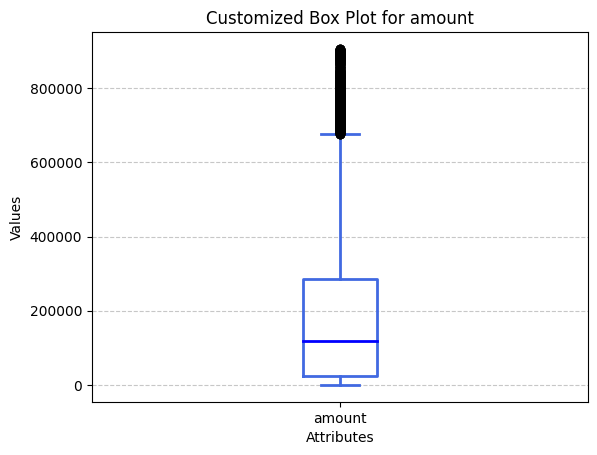

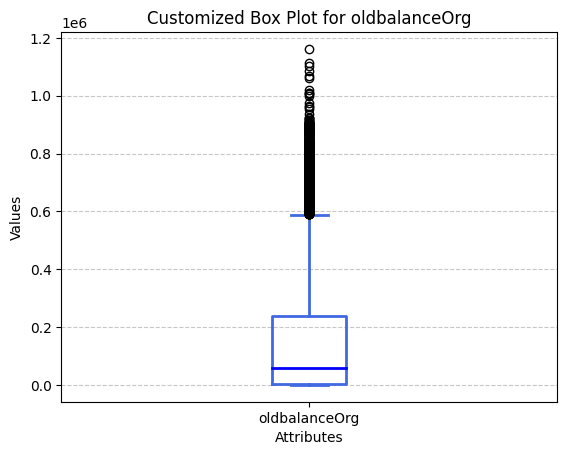

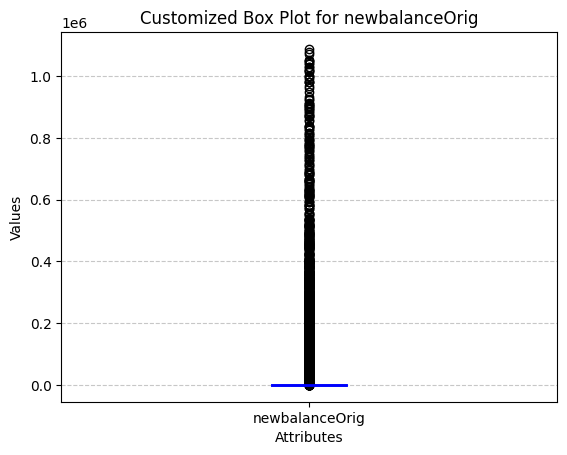

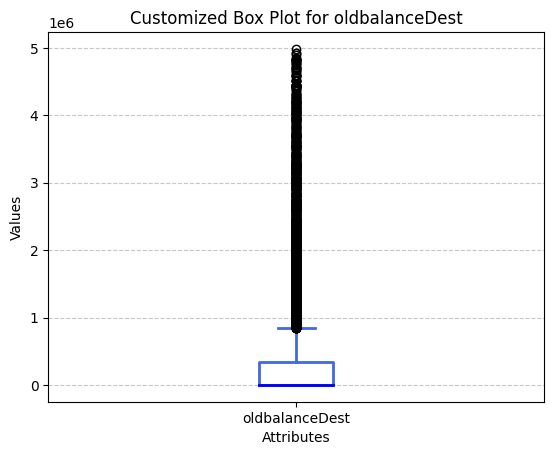

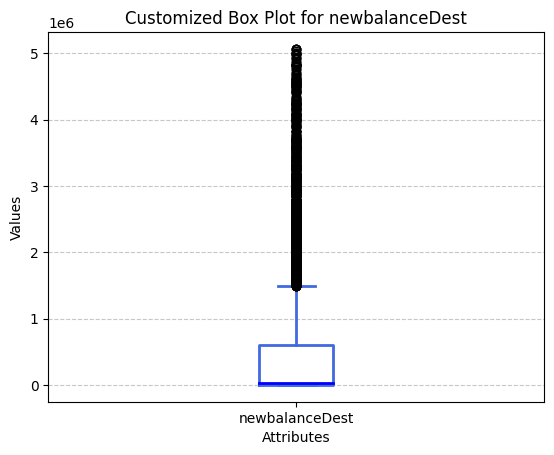

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Select the attributes for box plot analysis
attributes = ['amount', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Customize the appearance of the box plots
customizations = {
    'boxes': dict(color='royalblue', linewidth=2),
    'whiskers': dict(color='royalblue', linewidth=2),
    'caps': dict(color='royalblue', linewidth=2),
    'medians': dict(color='blue', linewidth=2),
}

# Create box plots for each selected attribute
for attribute in attributes:
    # Create the box plot and store the box plot properties
    box = plt.boxplot(df[attribute], labels=[attribute])

    # Apply customizations to the box plot elements
    for element, customization in customizations.items():
        plt.setp(box[element], **customization)

    # Add horizontal grid lines
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Set axis labels and title
    plt.xlabel('Attributes')
    plt.ylabel('Values')
    plt.title(f'Customized Box Plot for {attribute}')

    plt.show()


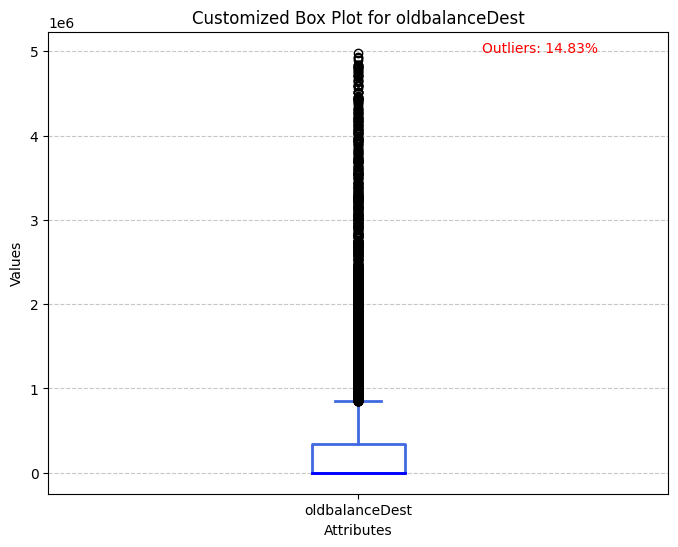

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Select the attribute for the box plot analysis
attribute = 'oldbalanceDest'

# Create the box plot
plt.figure(figsize=(8, 6))
box = plt.boxplot(df[attribute], labels=[attribute])

# Customize the appearance of the box plot elements
customizations = {
    'boxes': dict(color='royalblue', linewidth=2),
    'whiskers': dict(color='royalblue', linewidth=2),
    'caps': dict(color='royalblue', linewidth=2),
    'medians': dict(color='blue', linewidth=2),
}

# Apply customizations to the box plot elements
for element, customization in customizations.items():
    plt.setp(box[element], **customization)

# Calculate the percentage of outliers
q1 = df[attribute].quantile(0.25)
q3 = df[attribute].quantile(0.75)
iqr = q3 - q1
lower_bound = q1 - 1.5 * iqr
upper_bound = q3 + 1.5 * iqr
outliers = df[(df[attribute] < lower_bound) | (df[attribute] > upper_bound)]
outlier_percentage = len(outliers) / len(df) * 100

# Add a text annotation for the outlier percentage
plt.annotate(f'Outliers: {outlier_percentage:.2f}%', xy=(1.2, df[attribute].max() + 5), color='red')

# Add horizontal grid lines
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Set axis labels and title
plt.figure(figsize=(12,12))
plt.xlabel('Attributes')
plt.ylabel('Values')
plt.title(f'Customized Box Plot for {attribute}')

plt.show()


In [ ]:
# For categorical vs. numerical attributes
plt.figure(figsize=(8, 6))
sns.boxplot(x=x, y=y, data=df, palette='Set1')
plt.title(f'Box Plot: {x} vs. {y}')

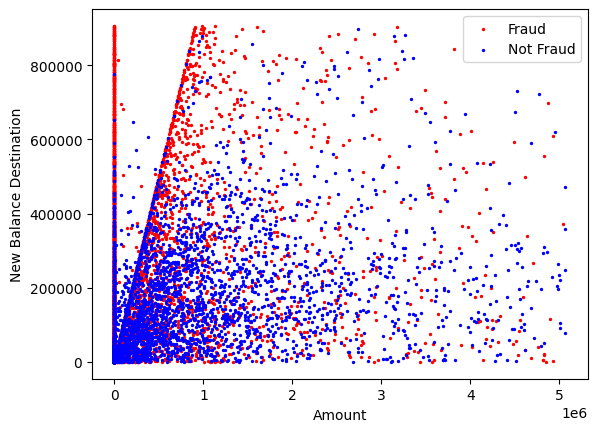

In [ ]:
# Create a scatter plot
plt.scatter( df[df['isFraud'] == 1]['newbalanceDest'], df[df['isFraud'] == 1]['amount'],s=2, c='red', label='Fraud')
plt.scatter(df[df['isFraud'] == 0]['newbalanceDest'],df[df['isFraud'] == 0]['amount'], s=2, c='blue', label='Not Fraud')

# Set labels and legend
plt.xlabel('Amount')
plt.ylabel('New Balance Destination')
plt.legend()

plt.show()

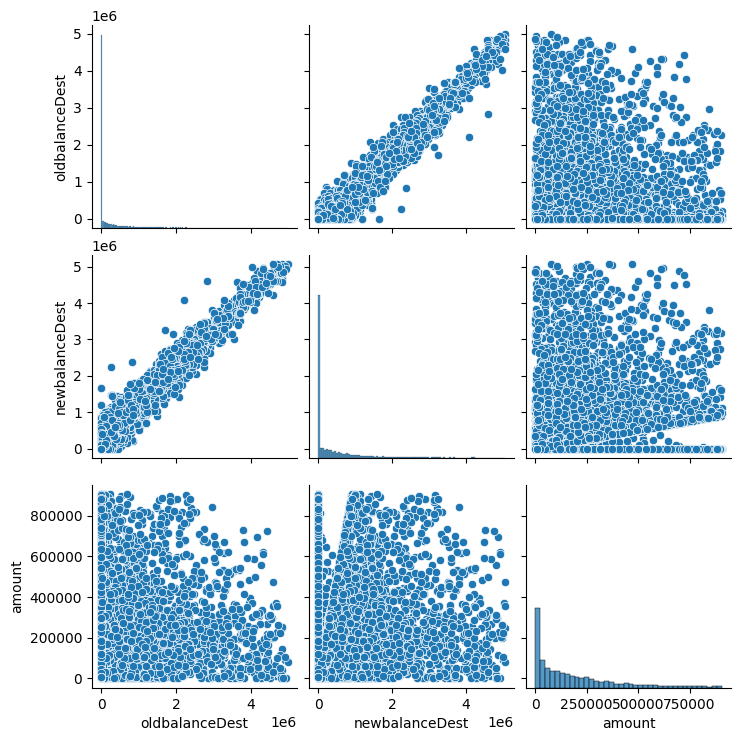

In [ ]:
# Example data (replace with your actual data)
data = df[['oldbalanceDest', 'newbalanceDest', 'amount']]

# Create a scatter plot matrix
sns.pairplot(data)
plt.show()

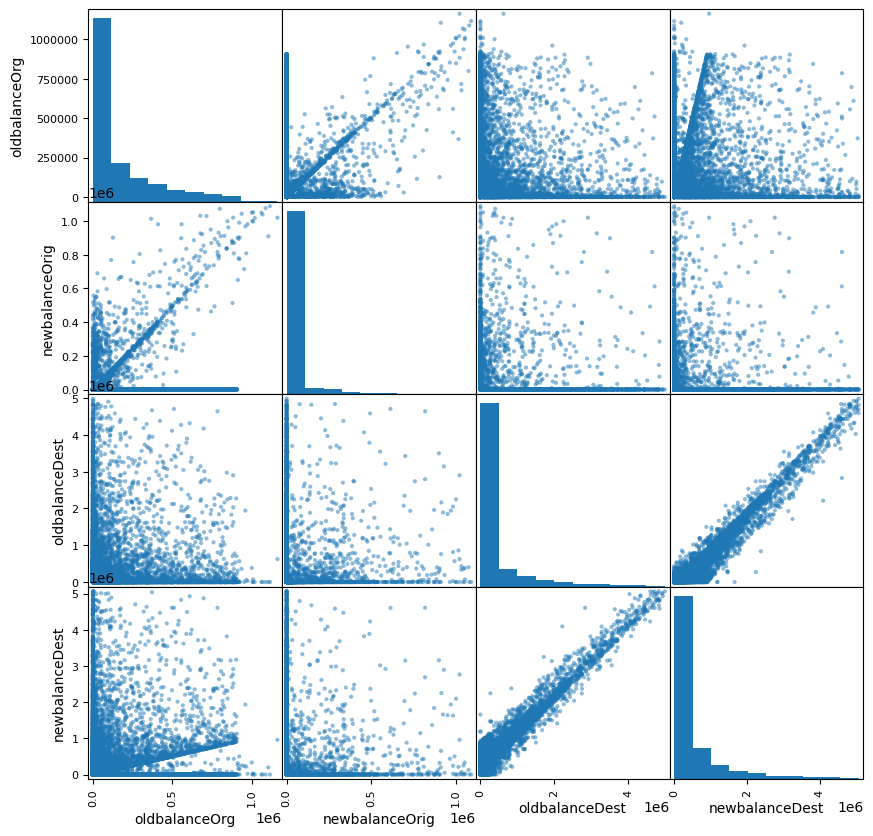

In [ ]:
pd.plotting.scatter_matrix(df[['oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest',
       'newbalanceDest']],figsize=(10, 10))
plt.show()

In [ ]:
attributes = ['oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest','newbalanceDest']
plt.hist(df['newbalanceDest'], bins=10, color='skyblue', edgecolor='black')
plt.box(df['newbalanceDest'].value_counts())

Error in callback <function _draw_all_if_interactive at 0x7bbd8a7f9990> (for post_execute):


ValueError: ignored

ValueError: ignored

<Figure size 640x480 with 1 Axes>

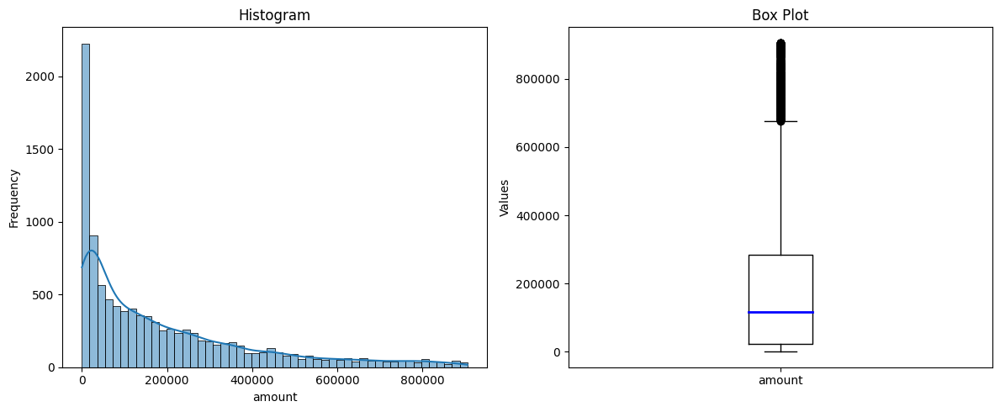

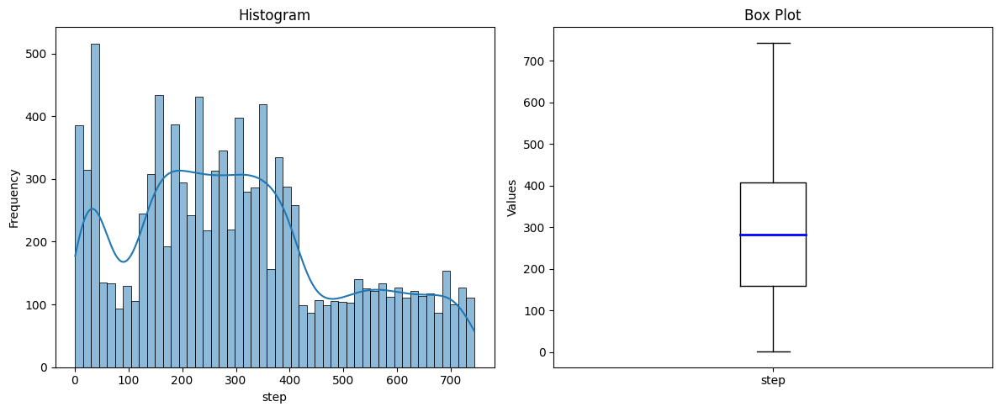

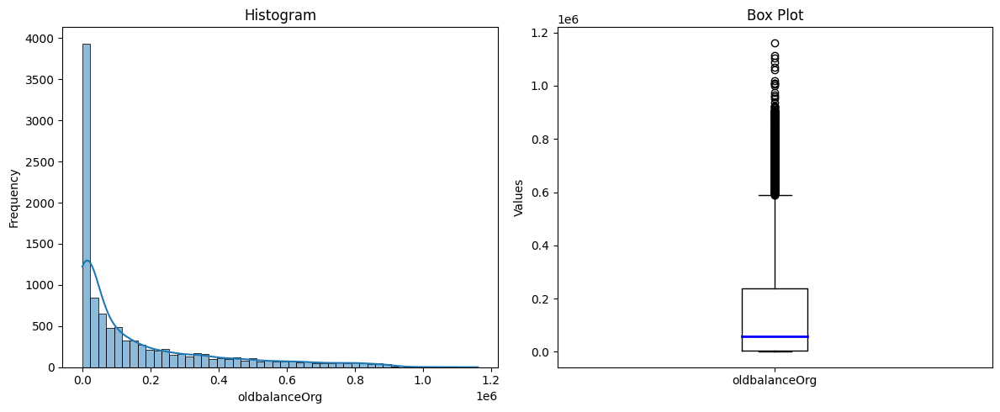

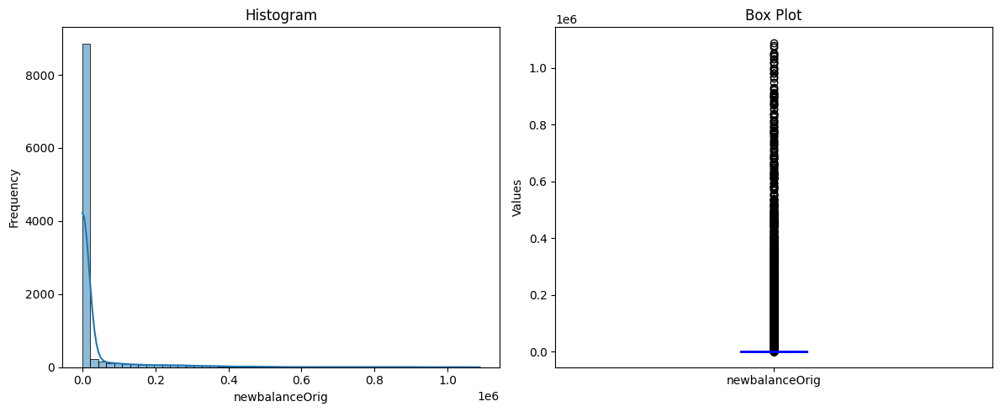

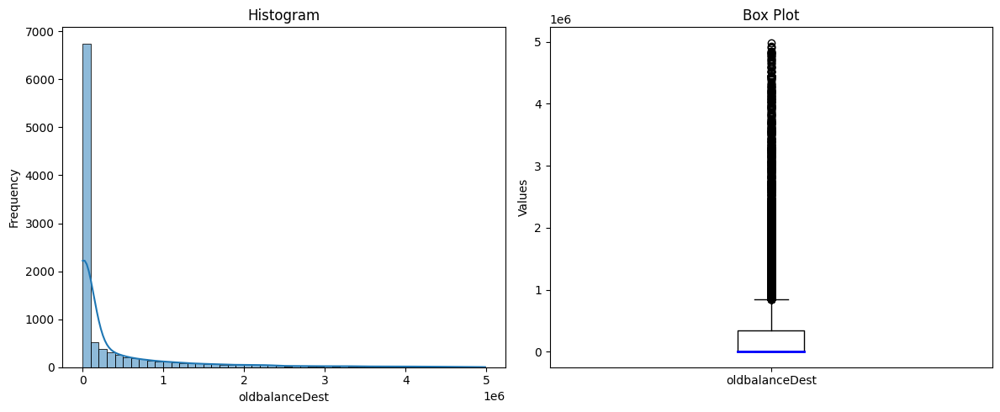

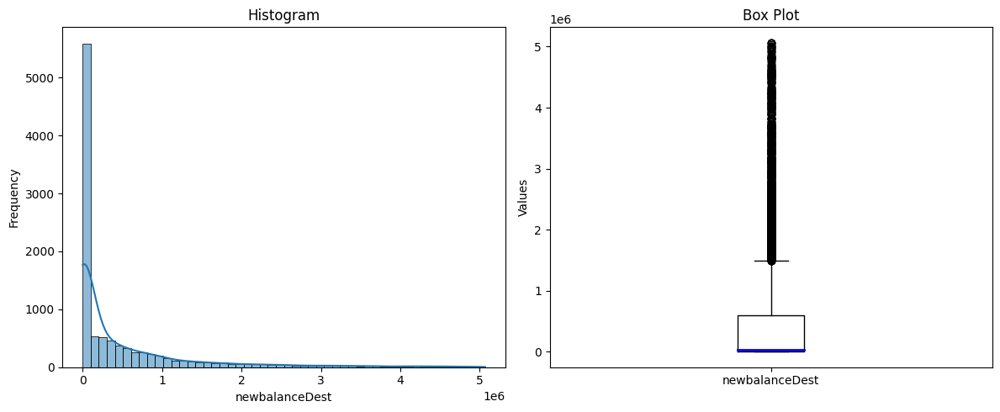

In [ ]:
# Example data (replace with your actual data)
atts = ['amount', 'step' ,'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest',
       'newbalanceDest']
for attribute in atts:
  # Create a figure with two subplots
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

  # Create a histogram in the first subplot
  sns.histplot(data=df[attribute], bins=50,kde=True, fill=True, alpha=0.5, ax=ax1)
  ax1.set_xlabel(attribute)
  ax1.set_ylabel('Frequency')
  ax1.set_title('Histogram')

  # Create a box plot in the second subplot
  ax2.boxplot(df[attribute])['medians'][0].set(color='blue', linewidth=2)
  ax2.set_ylabel('Values')
  ax2.set_xticklabels([attribute])
  ax2.set_title('Box Plot')

  # Adjust the layout to prevent overlap
  plt.tight_layout()

  # Show the subplots
  plt.show()

<Axes: xlabel='amount', ylabel='Count'>

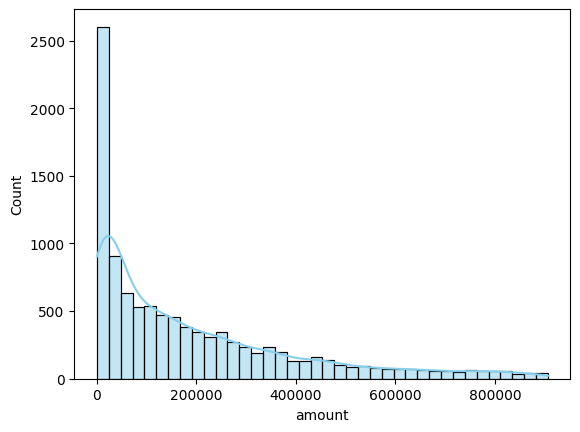

In [ ]:
sns.histplot(df['amount'], kde=True, color='skyblue', line_kws={'color': 'green'})

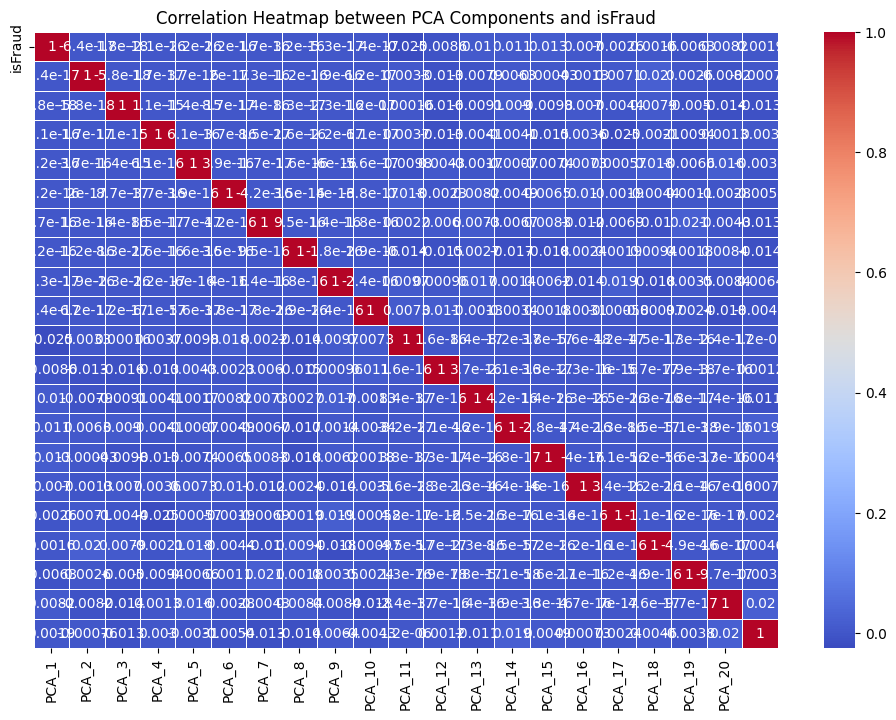

In [ ]:
# Select the PCA components and 'isFraud' column
pca_components = df[['PCA_1', 'PCA_2',
       'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
       'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17',
       'PCA_18', 'PCA_19', 'PCA_20']]
is_fraud = df[['isFraud']]

# Create a combined DataFrame for correlation calculation
correlation_df = pd.concat([pca_components, is_fraud], axis=1)

# Calculate the correlation matrix
correlation_matrix = correlation_df.corr()

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', xticklabels=pca_components.columns,
            yticklabels=['isFraud'], cbar=True, linewidths=0.5)

plt.title('Correlation Heatmap between PCA Components and isFraud')
plt.show()

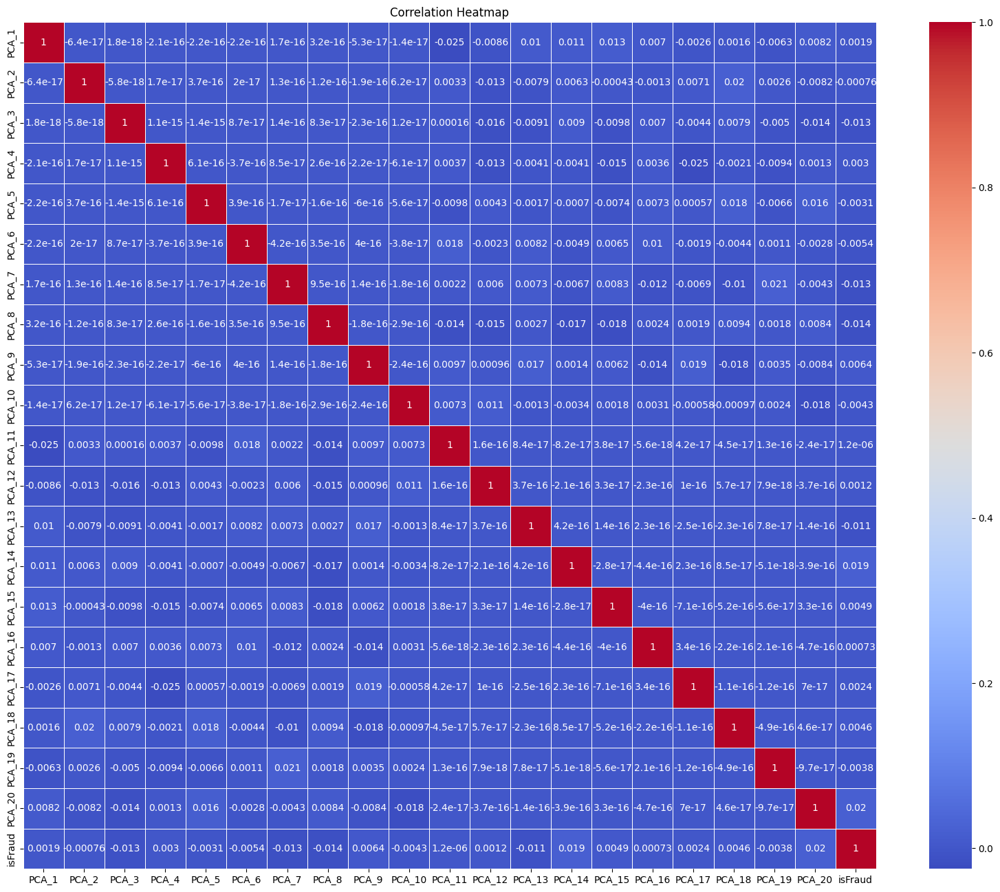

In [ ]:
selected_features = df[['PCA_1', 'PCA_2',
       'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
       'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17',
       'PCA_18', 'PCA_19', 'PCA_20', 'isFraud']]

correlation_matrix = selected_features.corr()

plt.figure(figsize=(20, 16))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

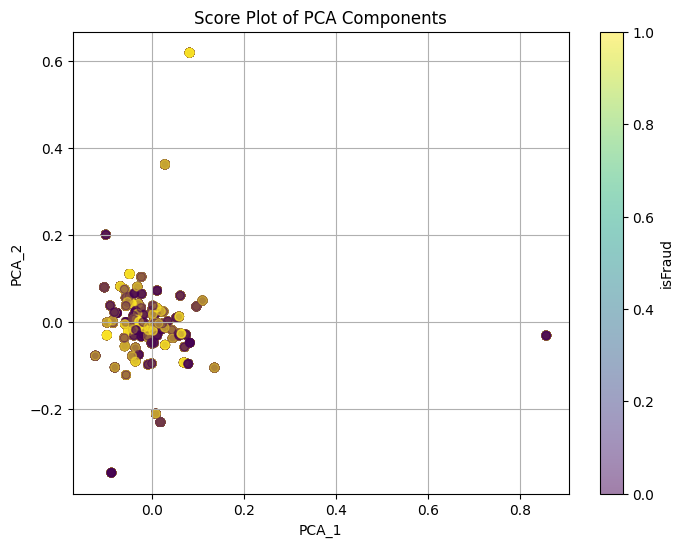

In [ ]:
# Assuming you have PCA results stored in pca_components and 'isFraud' as the target variable
# Select the first and second principal components for the score plot
pca1 = pca_components['PCA_1']
pca2 = pca_components['PCA_2']

# Create a score plot
plt.figure(figsize=(8, 6))
plt.scatter(pca1, pca2, c=df['isFraud'], cmap='viridis', alpha=0.5)
cbar = plt.colorbar()
cbar.set_label('isFraud')

plt.xlabel('PCA_1')
plt.ylabel('PCA_2')
plt.title('Score Plot of PCA Components')
plt.grid()
plt.show()


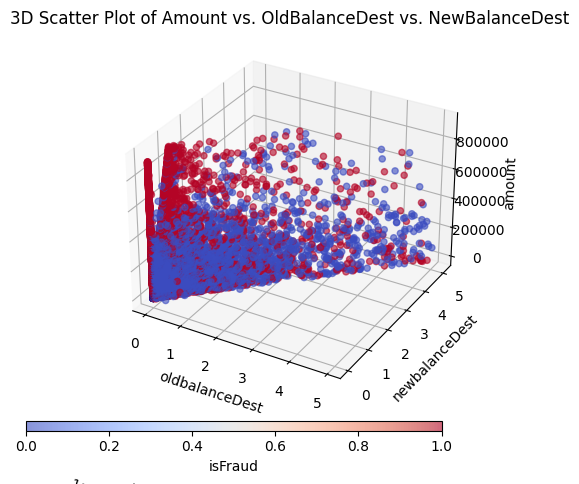

<Figure size 800x600 with 0 Axes>

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

# Create a score plot
fig = plt.figure()
plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
a = ax.scatter(df['oldbalanceDest'], df['newbalanceDest'], df['amount'], c=df['isFraud'], cmap='coolwarm', alpha=0.6)

# Set labels for the axes
ax.set_zlabel('amount')
ax.set_xlabel('oldbalanceDest')
ax.set_ylabel('newbalanceDest')

# Add a title
ax.set_title('3D Scatter Plot of Amount vs. OldBalanceDest vs. NewBalanceDest')

cax = fig.add_axes([0.1, 0.05, 0.65, 0.02])  # [left, bottom, width, height]
cbar = fig.colorbar(a, cax=cax, orientation='horizontal')
cbar.set_label('isFraud')

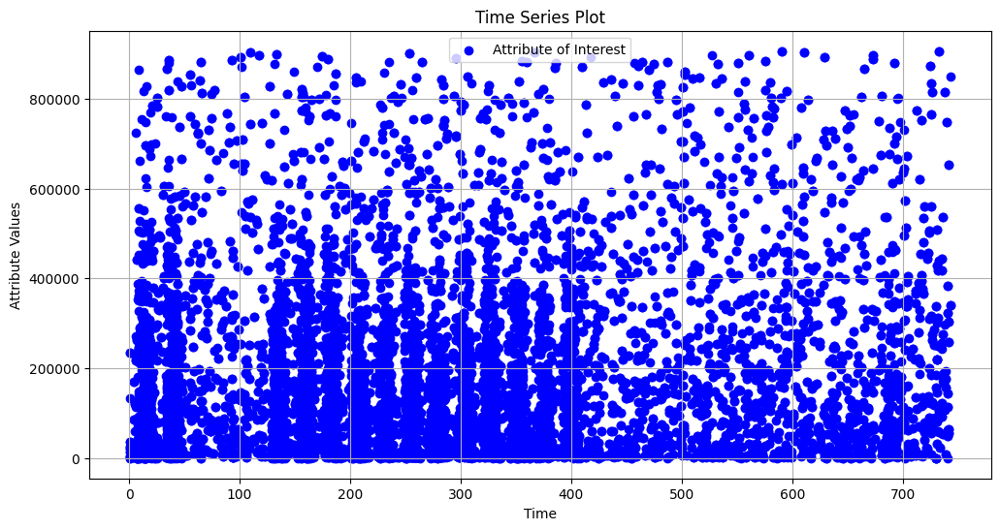

In [ ]:
# Create a time series plot
plt.figure(figsize=(12, 6))
plt.scatter(df['step'], df['amount'], color='blue', label='Attribute of Interest')
plt.xlabel('Time')
plt.ylabel('Attribute Values')
plt.title('Time Series Plot')
plt.legend()
plt.grid(True)
plt.show()

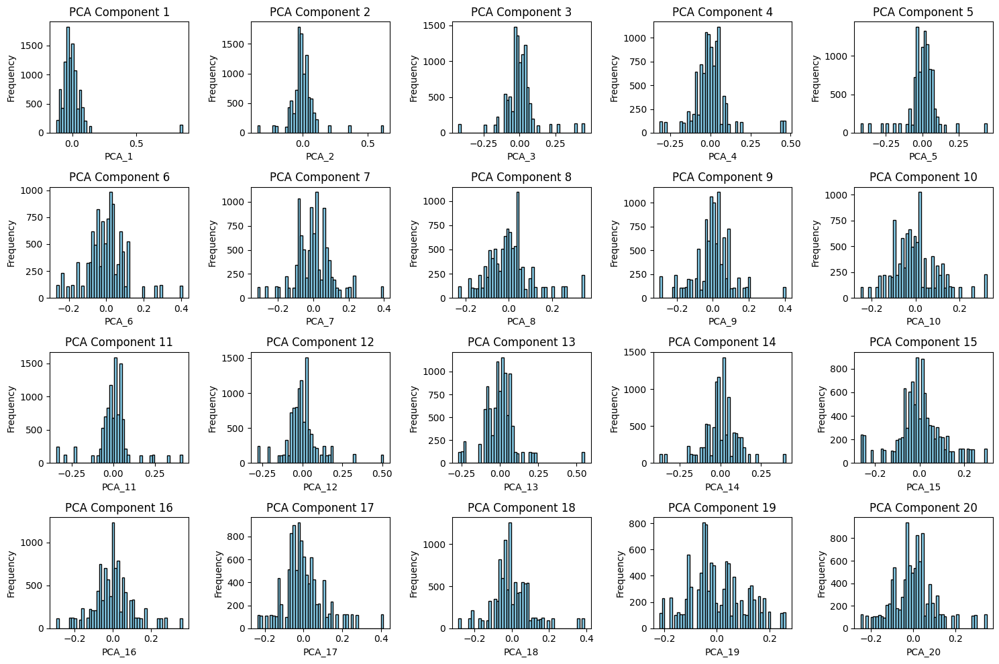

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have a DataFrame 'df' with PCA components as columns
pca_columns = ['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
               'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17', 'PCA_18', 'PCA_19', 'PCA_20']

# Define the number of rows and columns for subplots
n_rows = 4
n_cols = 5

# Create a figure with subplots
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Iterate through PCA columns and create subplots
for i, pca_col in enumerate(pca_columns):
    ax = axs[i]  # Select the current subplot
    ax.hist(df[pca_col], bins=50, color='skyblue', edgecolor='black')
    ax.set_title(f'PCA Component {i + 1}')
    ax.set_xlabel(pca_col)
    ax.set_ylabel('Frequency')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


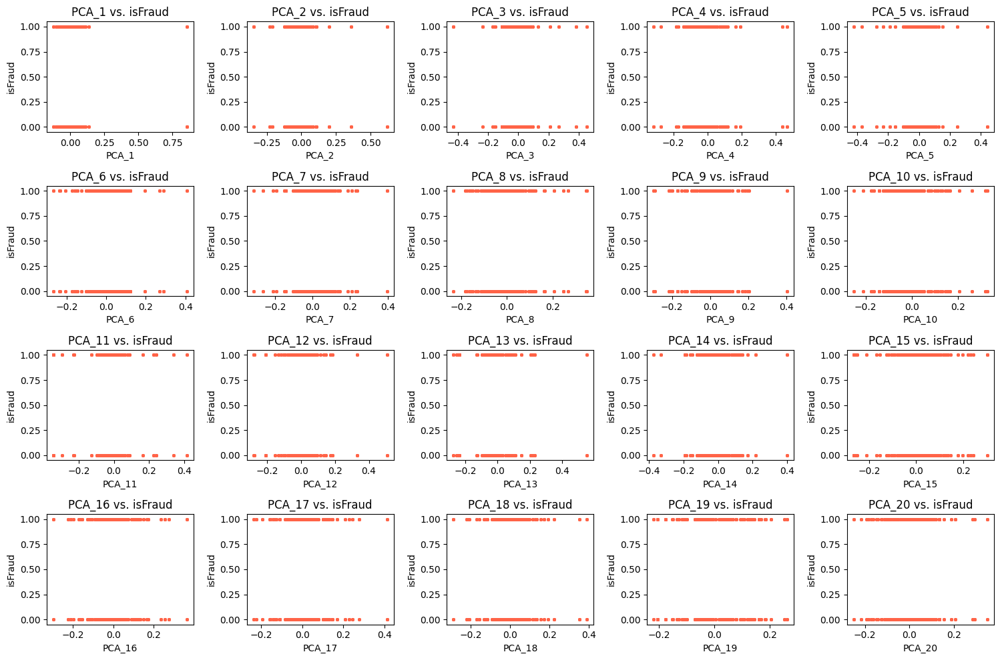

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have a DataFrame 'df' with PCA components as columns
pca_columns = ['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10',
               'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17', 'PCA_18', 'PCA_19', 'PCA_20']

# Create a figure with subplots
fig, axs = plt.subplots(nrows=4, ncols=5, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Iterate through PCA columns and create scatter plots
for i, pca_col in enumerate(pca_columns):
    ax = axs[i]  # Select the current subplot
    ax.scatter(df[pca_col], df['isFraud'], s=5, color='tomato', alpha=0.5)
    ax.set_title(f'PCA_{i + 1} vs. isFraud')
    ax.set_xlabel(pca_col)
    ax.set_ylabel('isFraud')

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


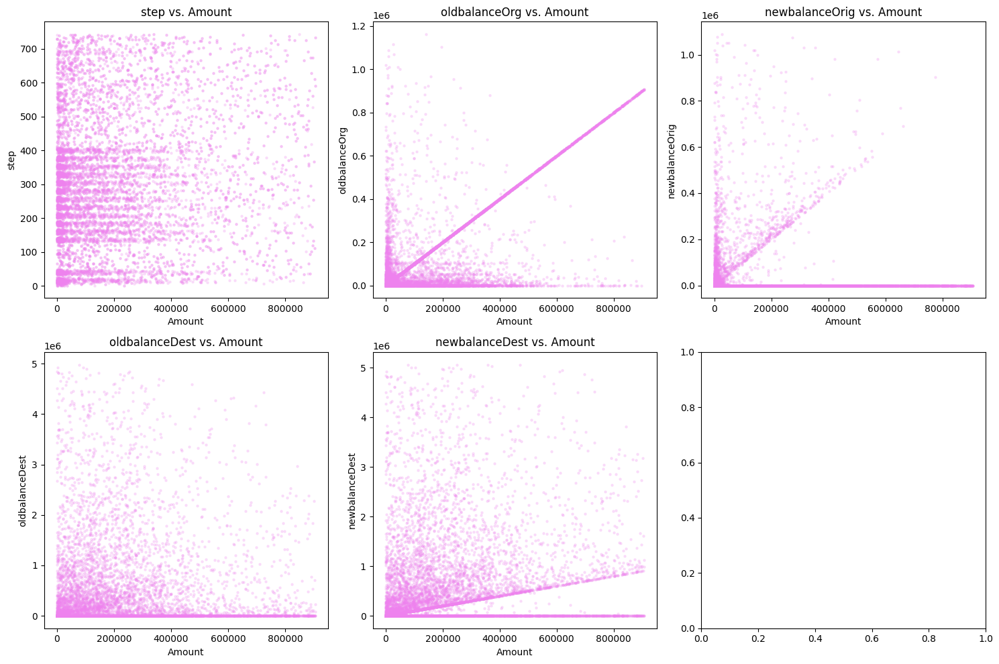

In [ ]:
import matplotlib.pyplot as plt

# List of attributes to plot
attributes = ['step', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Iterate through attributes and create scatter plots
for i, attr in enumerate(attributes):
    ax = axs[i]  # Select the current subplot
    ax.scatter(df['amount'], df[attr], s=5, color='violet', alpha=0.2)
    ax.set_title(f'{attr} vs. Amount')
    ax.set_xlabel('Amount')
    ax.set_ylabel(attr)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


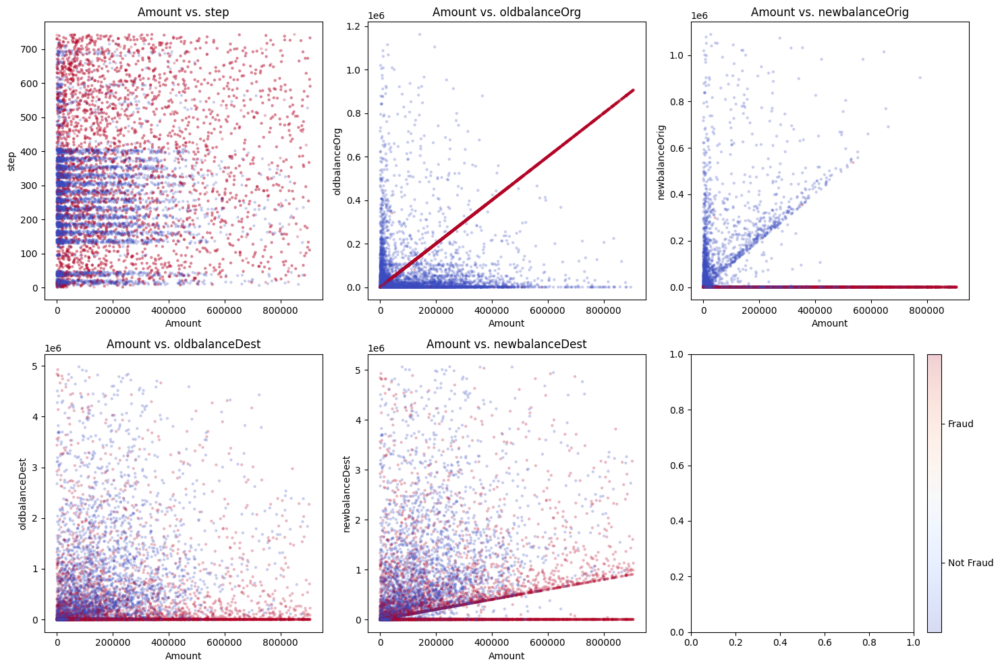

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# List of attributes to plot
attributes = ['step', 'oldbalanceOrg', 'newbalanceOrig', 'oldbalanceDest', 'newbalanceDest']

# Create a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

# Flatten the 2D array of subplots to access each subplot individually
axs = axs.ravel()

# Define a colormap for isFraud
cmap = plt.get_cmap('Set1', 2)  # Choose a colormap with 2 colors (for isFraud)

# Map isFraud values to colors
colors = [cmap(i) for i in df['isFraud']]

# Iterate through attributes and create scatter plots with color strip
for i, attr in enumerate(attributes):
    if i < len(axs):
        ax = axs[i]  # Select the current subplot
        scatter = ax.scatter(df['amount'], df[attr], s=5, c=df['isFraud'], cmap='coolwarm', alpha=0.2)
        ax.set_title(f'Amount vs. {attr}')
        ax.set_xlabel('Amount')
        ax.set_ylabel(attr)

# Add a colorbar to the last subplot
cbar = plt.colorbar(scatter, ax=axs[-1])
cbar.set_ticks([0.25, 0.75])
cbar.set_ticklabels(['Not Fraud', 'Fraud'])

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the figure with subplots
plt.show()


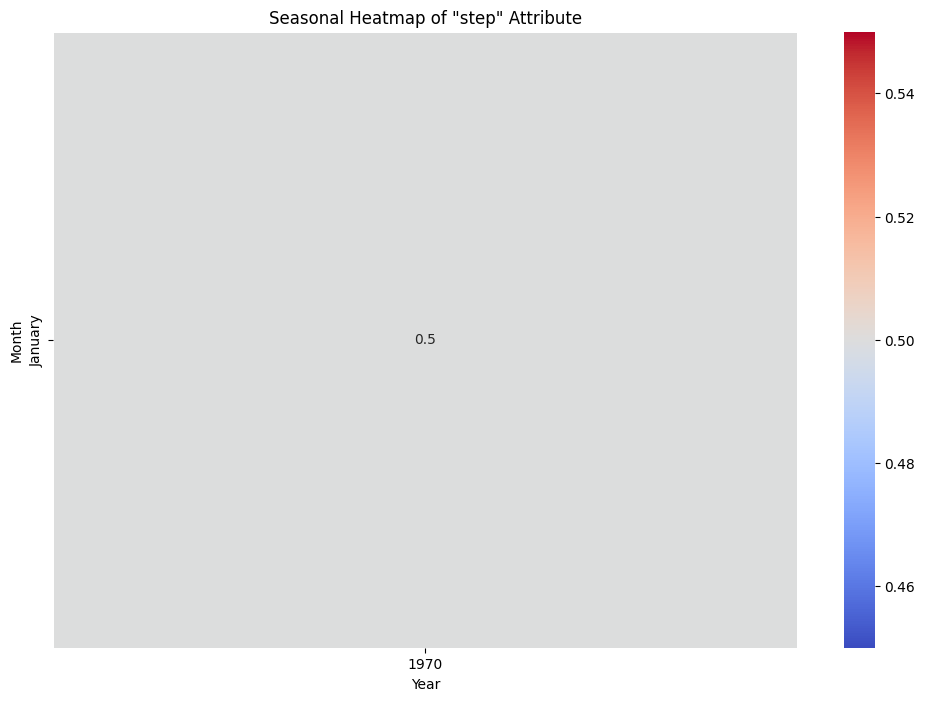

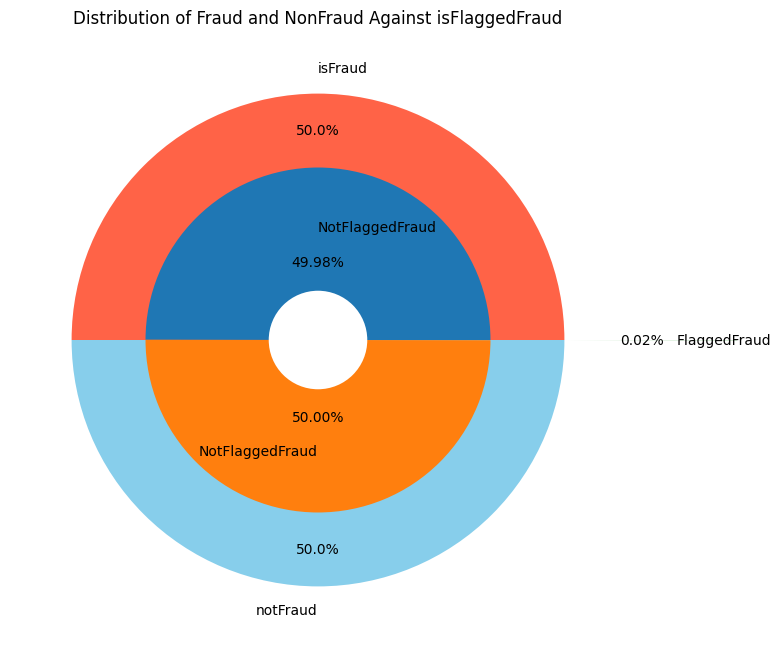

In [ ]:
labels = ['NotFlaggedFraud', 'NotFlaggedFraud', 'FlaggedFraud']
plt.figure(figsize=(8,8))
explode = (0, 2)
transaction = 'type_DEBIT'
plt.pie(df['isFraud'].value_counts(), labels=['isFraud', 'notFraud'],autopct='%1.1f%%', startangle=0, pctdistance=0.85, colors=['tomato','skyblue'])
fraud_in_type = len(df[(df['isFlaggedFraud'] == 1) & (df['isFraud'] == 1)])
#not_fraud_in_type = len(df[(df['isFlaggedFraud'] == 1) & (df['isFraud'] == 0)])
fraud_in_others = len(df[(df['isFlaggedFraud'] == 0) & (df['isFraud'] == 1)])
not_fraud_in_others = len(df[(df['isFlaggedFraud'] == 0) & (df['isFraud'] == 0)])

ins=plt.pie([fraud_in_others, not_fraud_in_others, fraud_in_type],
            labels=labels,
      autopct="%0.2f%%",radius=0.7,pctdistance=0.45,labeldistance=0.65,startangle=0, explode=(0,0,1))
hole = plt.Circle((0, 0), 0.2, color='white', linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(hole)
plt.title("Distribution of Fraud and NonFraud Against isFlaggedFraud")
plt.show()



In [ ]:
len(df['isFraud'])

5186

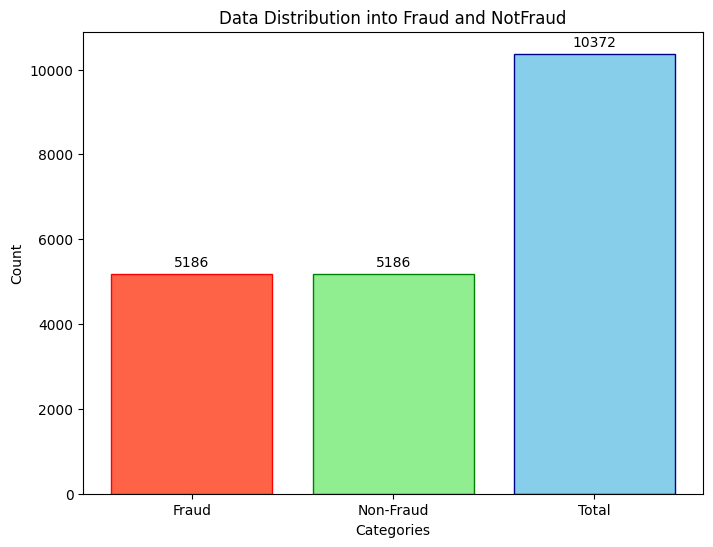

In [ ]:
import matplotlib.pyplot as plt

# Sample data (replace with your actual data)
fraud_count = len(df[df['isFraud']==1])
non_fraud_count = len(df[df['isFraud']==0])
total_count = fraud_count + non_fraud_count

# Create a bar plot with three bars
categories = ['Fraud', 'Non-Fraud', 'Total']
counts = [fraud_count, non_fraud_count, total_count]
colors = ['tomato', 'lightgreen', 'skyblue']
outline_colors = ['red', 'green', 'darkblue']

plt.figure(figsize=(8, 6))
bars = plt.bar(categories, counts, color=colors, edgecolor=outline_colors)

# Add values on top of the bars
for bar in bars:
    height = bar.get_height()
    plt.annotate(f'{int(height)}', xy=(bar.get_x() + bar.get_width() / 2, height),
                 xytext=(0, 3), textcoords='offset points', ha='center', va='bottom')

# Set axis labels and title
plt.xlabel('Categories')
plt.ylabel('Count')
plt.title('Data Distribution into Fraud and NotFraud')

# Show the plot
plt.show()
